In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Data Preprocessing
from sklearn.preprocessing import LabelEncoder

# Scaling and Splitting
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.preprocessing import scale

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold

# Modelling
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC


#Unbalance problems
from imblearn.over_sampling import SMOTE

# Evaluation
from sklearn.metrics import f1_score,accuracy_score, precision_score,recall_score
from sklearn.metrics import confusion_matrix, classification_report, plot_confusion_matrix, roc_curve,roc_auc_score



import warnings 
warnings.filterwarnings(action='ignore')
sns.set()

In [2]:
df = pd.read_csv("possibleDataset/weatherAUS.csv")
df.isnull().sum(), df.shape

(Date                 0
 Location             0
 MinTemp           1485
 MaxTemp           1261
 Rainfall          3261
 Evaporation      62790
 Sunshine         69835
 WindGustDir      10326
 WindGustSpeed    10263
 WindDir9am       10566
 WindDir3pm        4228
 WindSpeed9am      1767
 WindSpeed3pm      3062
 Humidity9am       2654
 Humidity3pm       4507
 Pressure9am      15065
 Pressure3pm      15028
 Cloud9am         55888
 Cloud3pm         59358
 Temp9am           1767
 Temp3pm           3609
 RainToday         3261
 RainTomorrow      3267
 dtype: int64,
 (145460, 23))

## Data Preprocessing

In [3]:
df = df[df['RainTomorrow'].notna() & df['RainToday'].notna() & df['Sunshine'].notna()]

### Categorical Data

In [4]:
df['Date'] = pd.to_datetime(df['Date'])
df0 = df.copy()
df = df.drop('RainTomorrow',axis=1)
df['Month'] = df['Date'].dt.month
df['RainTomorrow'] = df0['RainTomorrow'] 

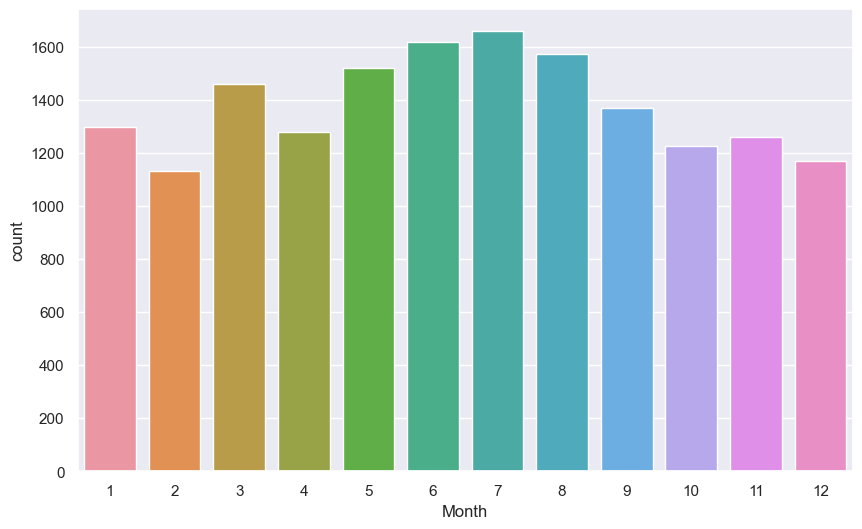

In [5]:
plt.figure(figsize=(10,6))
sns.countplot(data=df[df['RainTomorrow']=='Yes'],x='Month');

There are monts where the chances of raining increases, specially during summer

Location and Wind Directions are features that normaly have something to do with rains

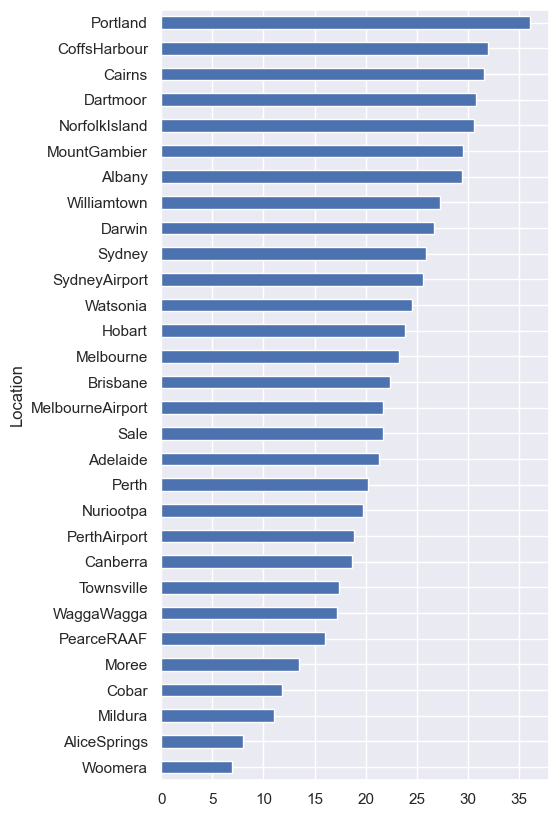

In [6]:
rainLoc_df=pd.crosstab(df['Location'],df['RainTomorrow']) 
# getting percentage of raining days and non raining days for each city 
rainLoc_df=rainLoc_df/rainLoc_df.transpose().sum().values.reshape((-1, 1))*100
rainLoc_sorted = rainLoc_df.sort_values(by='Yes',ascending=True )
rainLoc_sorted.Yes.plot(kind="barh",figsize=(5,10));

In [7]:
windgust_df=pd.crosstab(df['WindGustDir'],df['RainTomorrow']) 
windgust_df=windgust_df/windgust_df.transpose().sum().values.reshape((-1, 1))*100
windgust_df = windgust_df.sort_values(by='Yes',ascending=True )

In [8]:
winddir9am_df=pd.crosstab(df['WindDir9am'],df['RainTomorrow']) 
winddir9am_df=winddir9am_df/winddir9am_df.transpose().sum().values.reshape((-1, 1))*100
winddir9am_df = winddir9am_df.sort_values(by='Yes',ascending=True )

In [9]:
winddir3pm_df=pd.crosstab(df['WindDir3pm'],df['RainTomorrow']) 
winddir3pm_df=winddir3pm_df/winddir3pm_df.transpose().sum().values.reshape((-1, 1))*100
winddir3pm_df = winddir3pm_df.sort_values(by='Yes',ascending=True )

<AxesSubplot:>

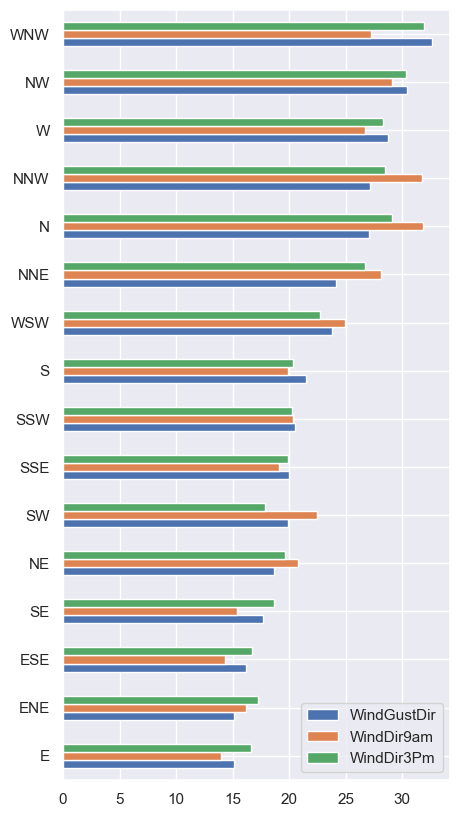

In [10]:
windDirs = pd.concat([windgust_df.Yes, winddir9am_df.Yes, winddir3pm_df.Yes], axis=1)
windDirs.columns = ['WindGustDir','WindDir9am','WindDir3Pm']
windDirs.plot(kind="barh",figsize=(5,10))

In [11]:
location_label_maping={}
for n, location in enumerate(rainLoc_sorted.index):
    location_label_maping[location] = n
df['Location'] = df['Location'].map(location_label_maping) 


windir_label_maping={}
for n, windir in enumerate(windDirs.index):
    windir_label_maping[windir] = n
df['WindGustDir'] = df['WindGustDir'].map(windir_label_maping)  
df['WindDir9am'] = df['WindDir9am'].map(windir_label_maping)  
df['WindDir3pm'] = df['WindDir3pm'].map(windir_label_maping)  

df['RainToday'] = df['RainToday'].map({'No':0, 'Yes':1})  

In [12]:
categorical = ['WindGustDir','WindDir9am','WindDir3pm','Location','RainToday']
df_labeled =  df.drop(['Date'],axis=1)
df_labeled.columns

Index(['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'Month', 'RainTomorrow'],
      dtype='object')

### Handling Outliers 

In [13]:
def box_plot(dataf_outliers, df_no_outliers):
    plt.figure(figsize=(10,4))
    fig, axes = plt.subplots(1, 2, figsize=(11, 5))
    sns.boxplot(data=dataf_outliers.values, palette='pastel', ax = axes[0])
    axes[0].set_title(f'Box Plot: {dataf_outliers.name} - With Outliers')
    sns.boxplot(data=df_no_outliers.values, palette='pastel', ax = axes[1])
    axes[1].set_title(f'Box Plot: {df_no_outliers.name} - Without Outliers')  
    plt.show()


def drop_outliers(dataf, colname):
    dfcol = dataf[colname]
    dfcol = dfcol[~np.isnan(dfcol)]
    iqr = 1.5*(np.percentile(dfcol,75)-np.percentile(dfcol,25))
    
    dataf.drop(dataf[dataf[colname] > (iqr + np.percentile(dfcol,75))].index, inplace=True)
    dataf.drop(dataf[dataf[colname] < (np.percentile(dfcol,25)-iqr)].index, inplace=True)
    return dataf[colname]

outliers: (73905,), no outliers: (73967,)


<Figure size 1000x400 with 0 Axes>

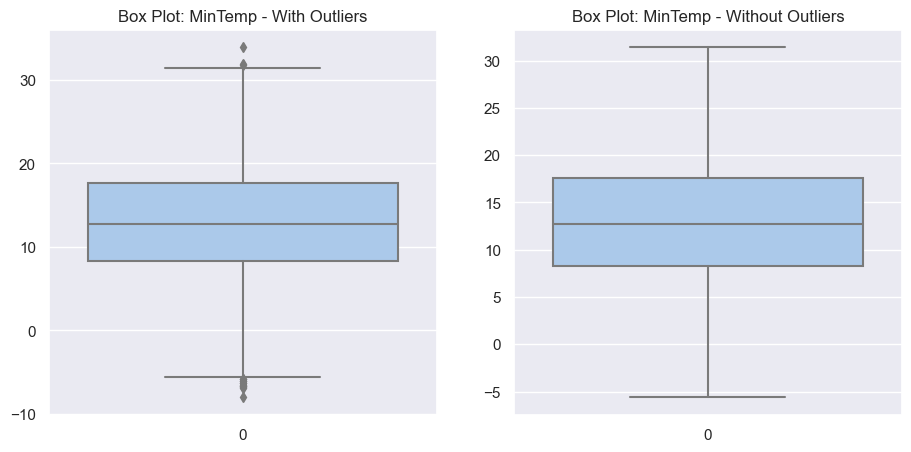

outliers: (73923,), no outliers: (73945,)


<Figure size 1000x400 with 0 Axes>

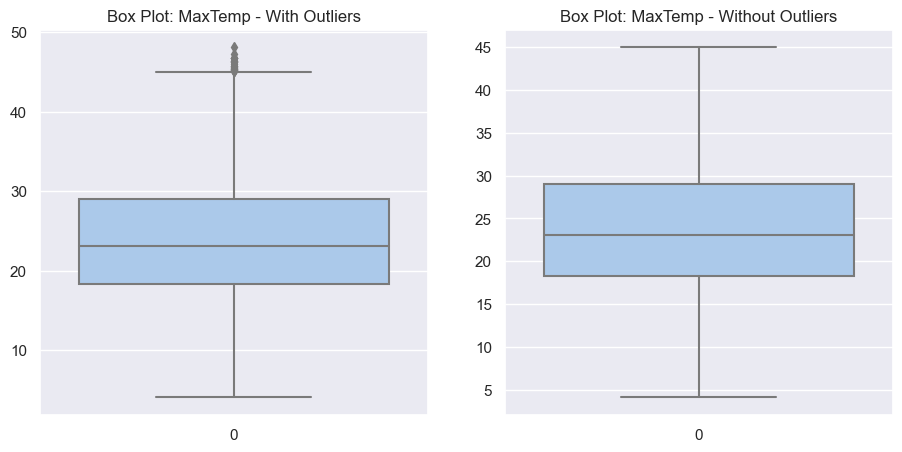

outliers: (73945,), no outliers: (60602,)


<Figure size 1000x400 with 0 Axes>

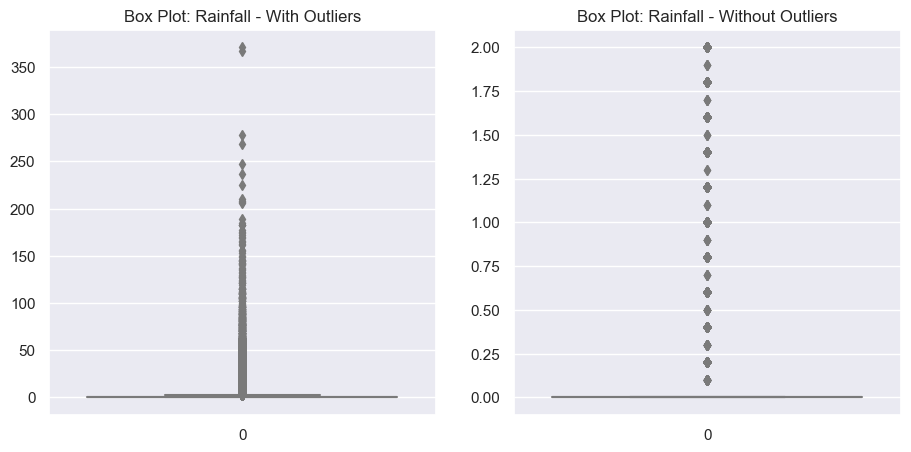

outliers: (57642,), no outliers: (59349,)


<Figure size 1000x400 with 0 Axes>

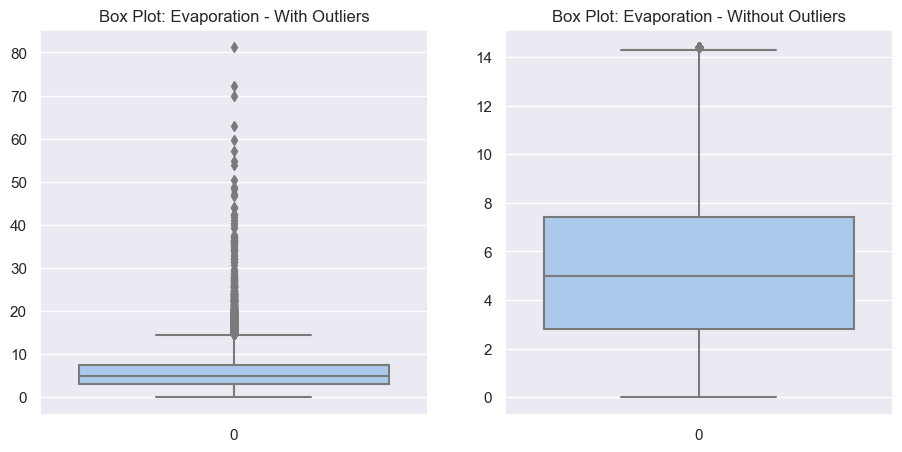

outliers: (59349,), no outliers: (59349,)


<Figure size 1000x400 with 0 Axes>

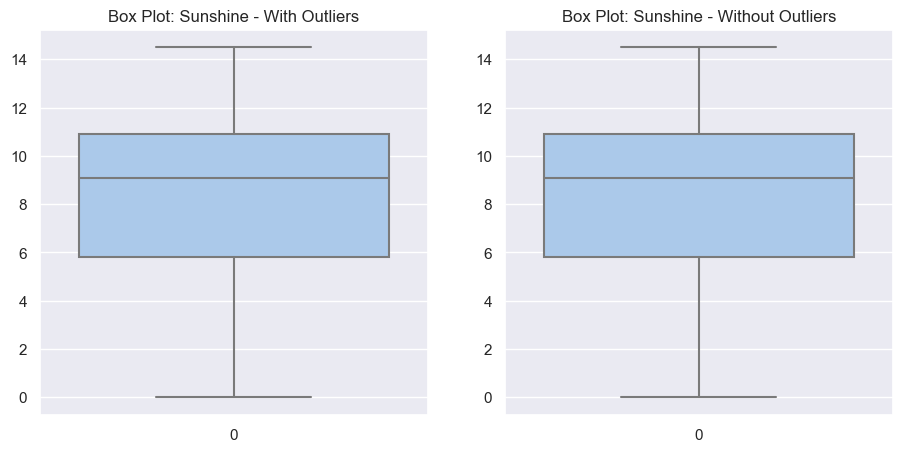

outliers: (56008,), no outliers: (57448,)


<Figure size 1000x400 with 0 Axes>

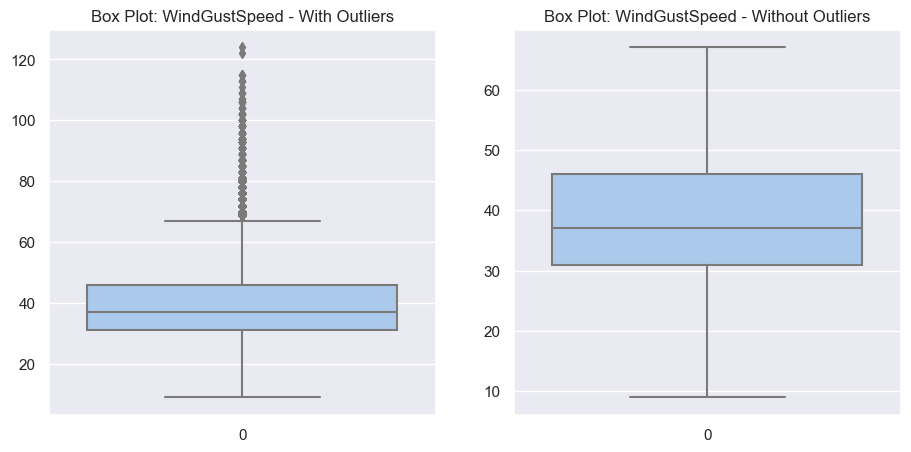

outliers: (57334,), no outliers: (56737,)


<Figure size 1000x400 with 0 Axes>

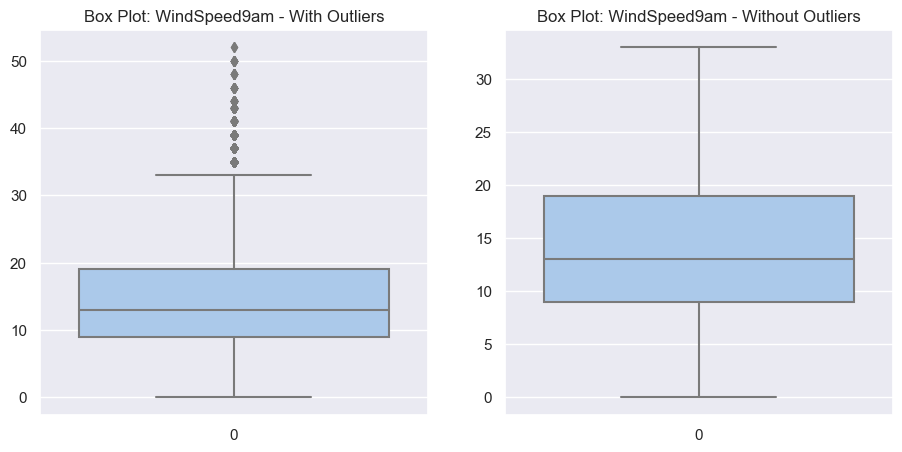

outliers: (56449,), no outliers: (56453,)


<Figure size 1000x400 with 0 Axes>

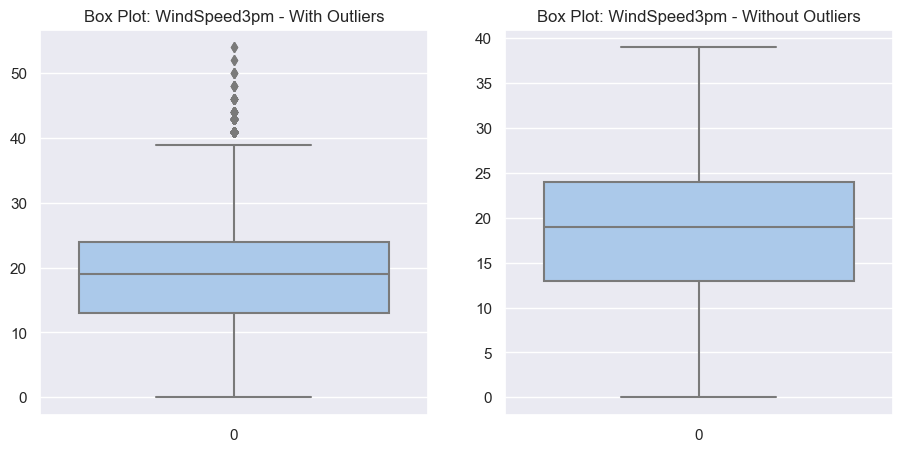

outliers: (56175,), no outliers: (55651,)


<Figure size 1000x400 with 0 Axes>

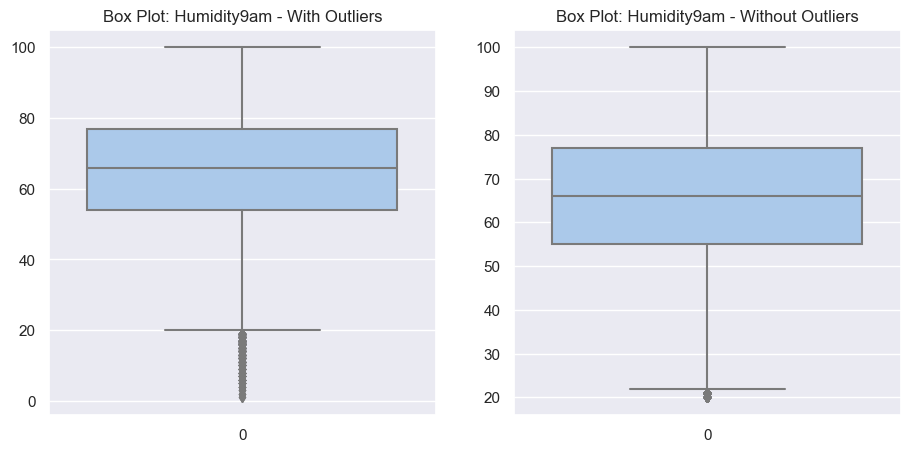

outliers: (55230,), no outliers: (55651,)


<Figure size 1000x400 with 0 Axes>

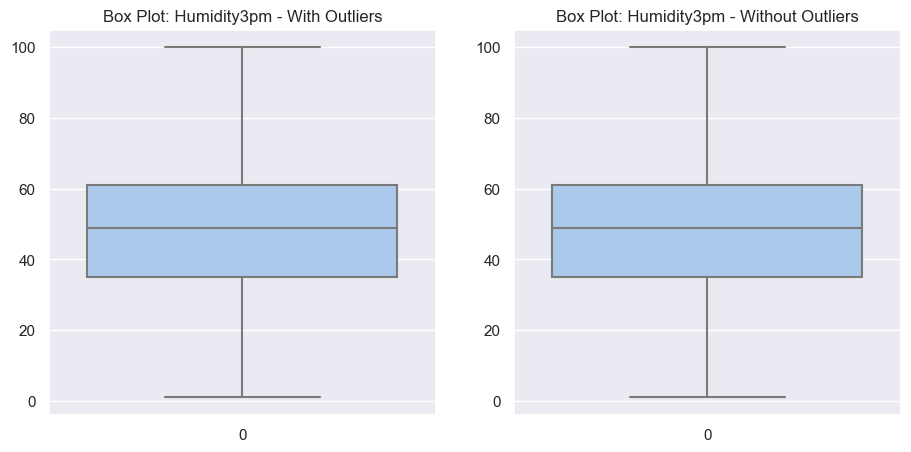

outliers: (55564,), no outliers: (55257,)


<Figure size 1000x400 with 0 Axes>

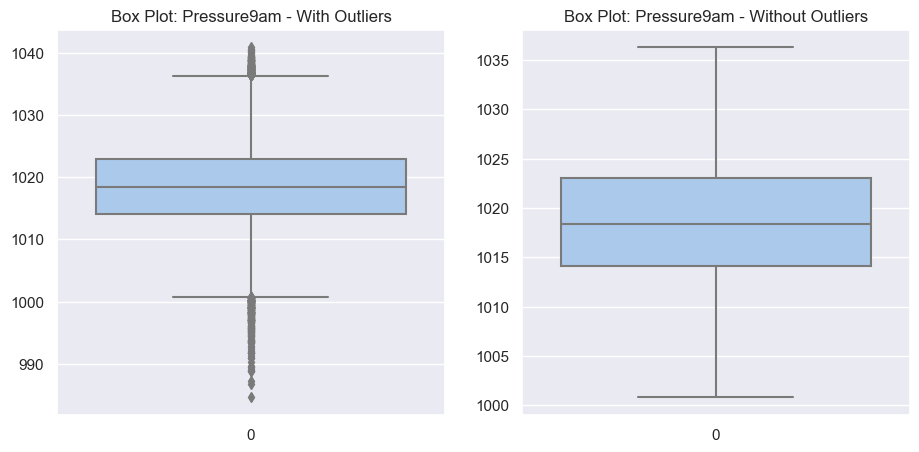

outliers: (55168,), no outliers: (55137,)


<Figure size 1000x400 with 0 Axes>

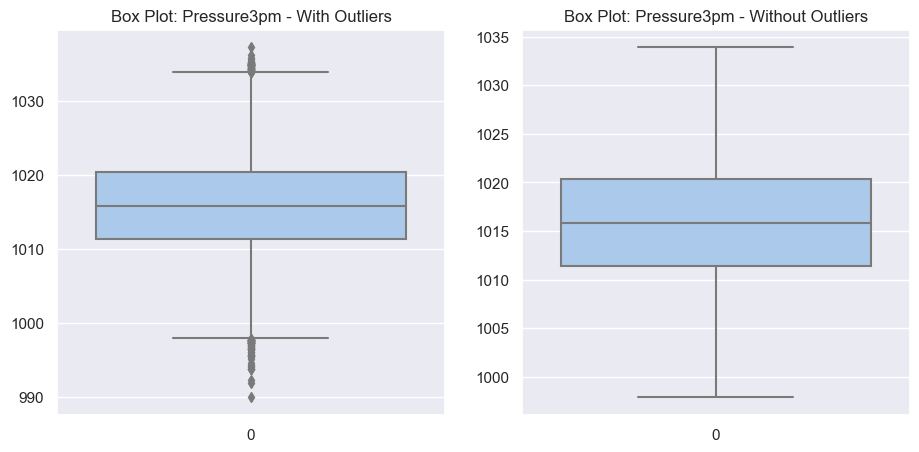

outliers: (49393,), no outliers: (55137,)


<Figure size 1000x400 with 0 Axes>

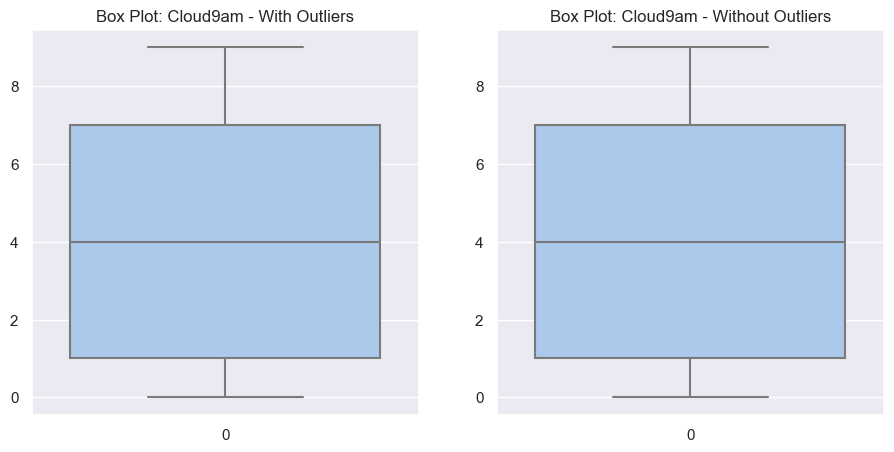

outliers: (48148,), no outliers: (55137,)


<Figure size 1000x400 with 0 Axes>

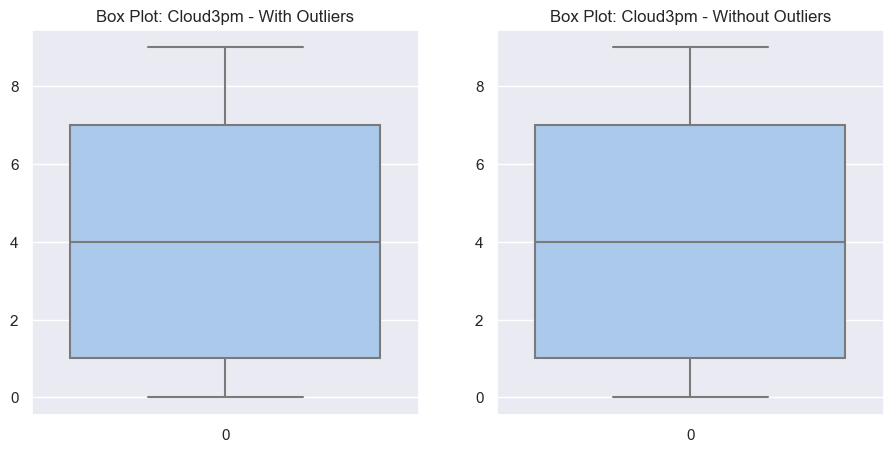

outliers: (55061,), no outliers: (55135,)


<Figure size 1000x400 with 0 Axes>

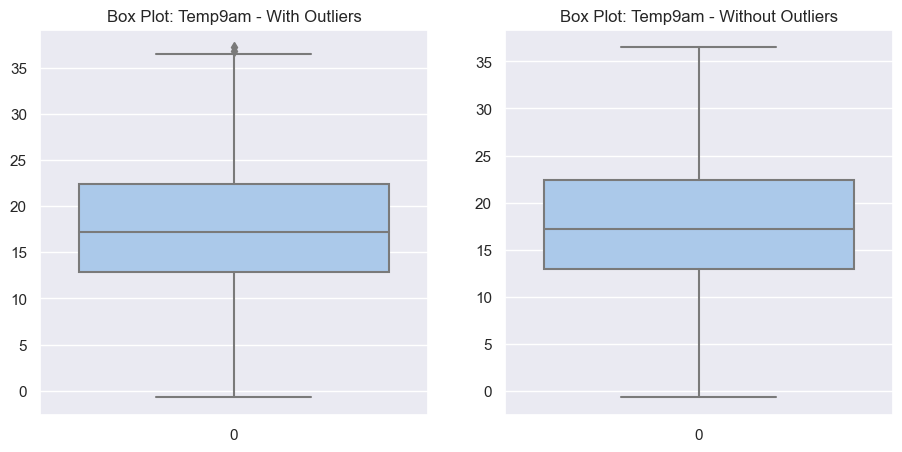

outliers: (54892,), no outliers: (55104,)


<Figure size 1000x400 with 0 Axes>

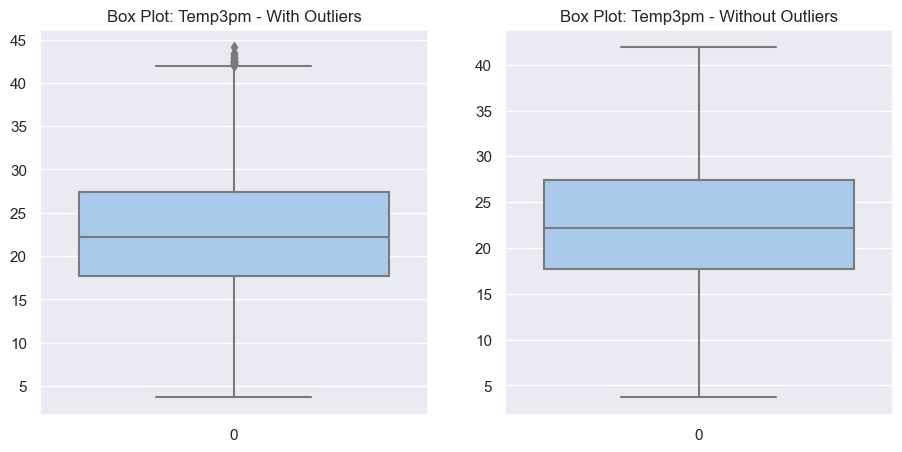

outliers: (55104,), no outliers: (55104,)


<Figure size 1000x400 with 0 Axes>

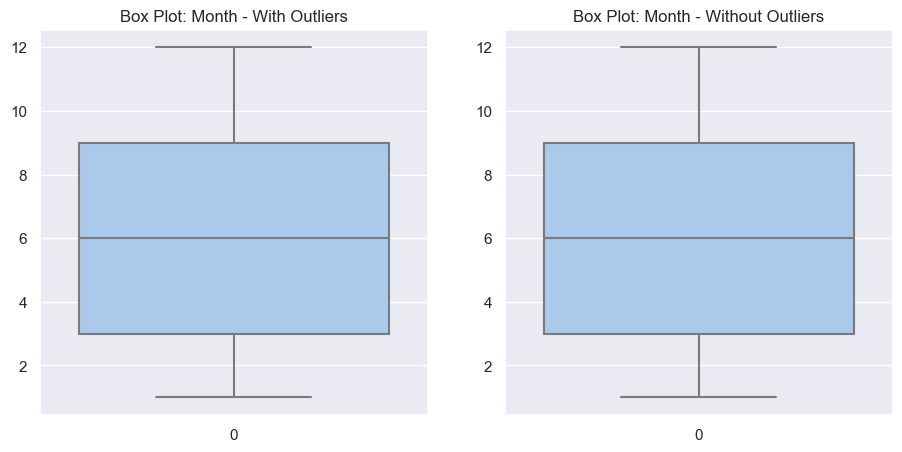

In [14]:
for col in df_labeled.columns:
    if col not in categorical + ['RainTomorrow']:
        dfcol = df_labeled[col]
        dfcol = dfcol[~np.isnan(dfcol)]
        df_no_outliers = drop_outliers(df_labeled, col)
        print(f'outliers: {dfcol.shape}, no outliers: {df_no_outliers.shape}')
        box_plot(dfcol, df_no_outliers)

### Handling Missing Values

In [15]:
def fill_mean(datacol):
    dataunique = datacol.unique()
    dataunique = dataunique[~np.isnan(dataunique)]
    data_mean = np.mean(dataunique)
    return datacol.fillna(data_mean)

In [16]:
for col in df_labeled.columns:
    if col not in ['RainTomorrow']:
        df_labeled[col] = fill_mean(df_labeled[col])

In [17]:
df_labeled.isnull().sum()

Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
Month            0
RainTomorrow     0
dtype: int64

In [18]:
df_labeled['RainTomorrow'] = df_labeled['RainTomorrow'].map({'No':0, 'Yes':1})  
X = df_labeled.drop('RainTomorrow',axis=1)
y = df_labeled['RainTomorrow']
X.shape

(55104, 22)

In [112]:
df_labeled0 = df_labeled.groupby('RainTomorrow', group_keys=False).apply(lambda x: x.sample(frac=0.1))
X = df_labeled0.drop('RainTomorrow',axis=1)
y = df_labeled0['RainTomorrow']
X

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
80769,18,8.4,19.0,0.0,6.6,7.8,5.0,33.00000,8.0,5.0,...,71.0,63.0,1013.8,1011.0,7.0,4.0,14.5,18.1,0,11
139655,21,26.0,32.7,0.0,5.0,5.5,11.0,28.00000,7.5,14.0,...,84.0,66.0,1006.9,1004.8,7.0,6.0,27.3,31.7,0,12
137319,1,8.2,19.8,0.0,3.8,9.2,8.0,31.00000,3.0,8.0,...,73.0,39.0,1021.1,1018.0,6.0,1.0,14.4,19.4,0,6
86764,15,15.9,27.3,0.4,4.2,6.3,2.0,19.00000,5.0,0.0,...,59.0,56.0,1020.7,1017.1,6.0,7.0,22.7,24.9,0,4
46119,8,2.9,19.0,0.0,7.2,10.8,14.0,43.00000,7.5,14.0,...,57.0,25.0,1015.2,1011.8,5.0,5.0,9.9,18.3,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142028,21,26.1,31.8,0.0,5.0,4.7,4.0,33.00000,1.0,4.0,...,68.0,63.0,1012.4,1007.8,7.0,7.0,28.9,29.6,0,9
140060,21,28.2,32.3,0.0,7.0,5.0,15.0,41.00000,15.0,15.0,...,80.0,68.0,1006.8,1003.8,8.0,7.0,29.2,31.9,0,2
108712,23,16.1,27.0,0.0,1.8,9.3,7.5,37.96875,1.0,7.0,...,81.0,77.0,1011.6,1005.8,4.0,6.0,20.0,22.2,0,4
21772,25,13.3,22.3,0.4,4.2,10.8,11.0,54.00000,4.0,11.0,...,68.0,66.0,1014.9,1011.2,3.0,5.0,19.4,21.6,0,10


In [20]:
mayority_weight = y.value_counts()[0]/y.shape[0]
minority_weight = y.value_counts()[1]/y.shape[0]
print(mayority_weight, minority_weight)

0.8446460980036298 0.15535390199637023


### Unbalance problems

Text(0.5, 1.0, '10% Subsample')

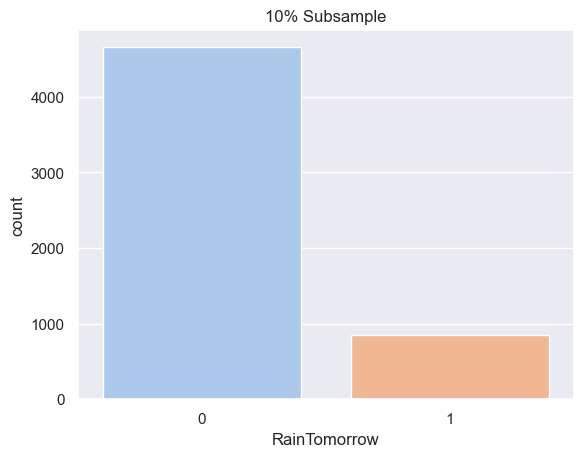

In [113]:
ax = sns.countplot(x=y, palette='pastel')
plt.title('10% Subsample')

## Functions

In [22]:
def store_metrics(metr, ytest, ypr):
    metr[0].append(roc_auc_score(ytest, ypr))
    metr[1].append(f1_score(ytest, ypr))
    metr[2].append(precision_score(ytest, ypr))
    metr[3].append(recall_score(ytest, ypr))
    return metr

In [131]:
def calculate_KNN(Xtrain_resampled,Xtrain,ytrain_resampled,ytrain,Xtest,ytest, neighbors = 30):
    aucscores_resampled = []
    aucscores = []
    
    for k in range(1,neighbors):
        knn = KNeighborsClassifier(n_neighbors = k, weights='distance')
        knn.fit(Xtrain_resampled, ytrain_resampled)
        ypred_resampled = knn.predict(Xtest) 
        ## computing f1 score
        score = roc_auc_score(ytest, ypred_resampled)
        aucscores_resampled.append(score)
        
        knn = KNeighborsClassifier(n_neighbors = k,weights='distance')
        knn.fit(Xtrain, ytrain)
        ypred = knn.predict(Xtest) 
        ## computing f1 score
        score = roc_auc_score(ytest, ypred)
        aucscores.append(score)


    fig, axes = plt.subplots(1, 2, figsize=(11, 5))
    sns.set(font_scale = 1)
    sns.lineplot(y=aucscores_resampled, x=range(1,neighbors), ax = axes[0])
    axes[0].set_title('Balanced Dataset')
    axes[0].set(xlabel='Neighbors', ylabel='ROC-AUC Score')
    sns.lineplot(y=aucscores, x=range(1,neighbors), ax = axes[1])
    axes[1].set_title('Unbalanced Dataset')
    axes[1].set(xlabel='Neighbors', ylabel='ROC-AUC Score')
    
    return np.where(aucscores==np.max(aucscores))[0][0]+1,np.where(aucscores_resampled==np.max(aucscores_resampled))[0][0] +1


<Figure size 3000x3000 with 0 Axes>

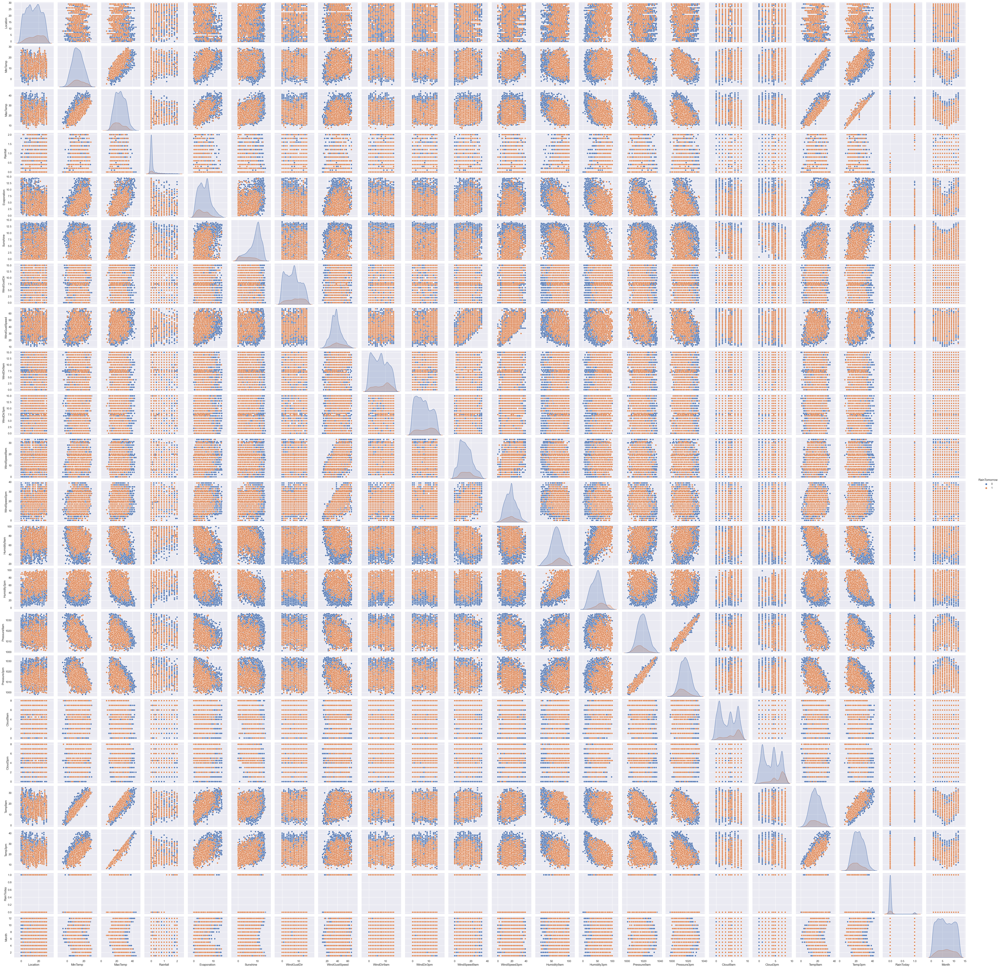

In [128]:
plt.figure(figsize=(30,30))
sns.pairplot(df_labeled0, hue="RainTomorrow")
plt.show()

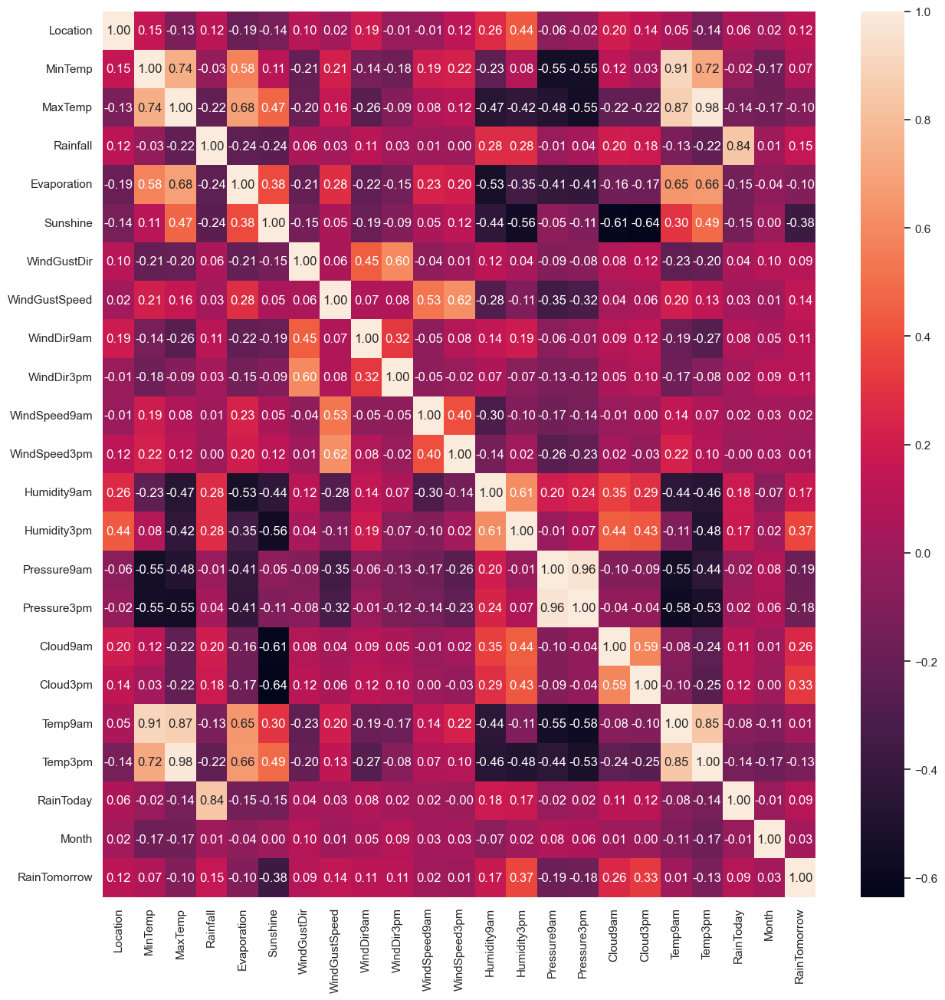

In [24]:
plt.figure(figsize=(15,15))
ax = sns.heatmap(df_labeled0.corr(), annot=True, fmt='.2f') 
plt.show()



# KNN

### SMOTE Oversampling

In [114]:

smote = SMOTE()
stscaler = StandardScaler()
normal = MinMaxScaler()
#normalization
Xnorm = stscaler.fit_transform(X)
Xnorm = pd.DataFrame(Xnorm, columns=X.columns)
Xnorm.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
0,0.403403,-0.686141,-0.776504,-0.399133,0.450196,-0.095578,-0.411394,-0.461410,0.222201,-0.408966,...,0.320616,0.784297,-0.764553,-0.780039,1.132434,-0.042907,-0.505111,-0.713339,-0.233117,1.343904
1,0.765730,2.120072,1.327037,-0.399133,-0.093970,-0.732314,0.934077,-0.953530,0.113168,1.564817,...,1.095097,0.944559,-1.853293,-1.747551,1.132434,0.756481,1.532434,1.429674,-0.233117,1.635816
2,-1.649781,-0.718029,-0.653670,-0.399133,-0.502094,0.292000,0.261341,-0.658258,-0.868126,0.248962,...,0.439766,-0.497795,0.387302,0.312312,0.758182,-1.241989,-0.521029,-0.508492,-0.233117,-0.115652
3,0.041077,0.509689,0.497904,0.626504,-0.366052,-0.510841,-1.084130,-1.839346,-0.431995,-1.505512,...,-0.394290,0.410354,0.324186,0.171867,0.758182,1.156175,0.800191,0.358168,-0.233117,-0.699474
4,-0.804352,-1.563082,-0.776504,-0.399133,0.654258,0.734947,1.606812,0.522830,0.113168,1.564817,...,-0.513441,-1.245682,-0.543650,-0.655199,0.383931,0.356787,-1.237353,-0.681824,-0.233117,-0.699474


In [115]:


#split into train and test
Xtrain, Xtest, ytrain, ytest = train_test_split(Xnorm, y, test_size=0.2, random_state=13)
Xtrain_resampled, ytrain_resampled = smote.fit_resample(Xtrain, ytrain)
Xtrain.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
1039,1.731934,-0.622363,-0.177686,-0.399133,0.246134,0.790315,1.382567,-0.658258,0.113168,0.248962,...,0.201465,1.104820,-0.748775,-0.311889,0.196805,-1.241989,0.322642,-0.429705,-0.233117,1.635816
2443,-0.925127,1.115576,0.651447,-0.399133,0.246134,0.624210,0.709832,-0.953530,1.530594,0.906889,...,0.797219,0.356933,-0.275409,-0.530359,0.383931,-1.241989,1.102639,0.815134,-0.233117,0.468171
2434,1.369608,-0.144031,-0.853276,3.190595,-1.386362,-2.254943,0.934077,-2.233042,0.113168,-0.408966,...,2.048304,2.226650,0.434638,0.483968,0.196805,0.156940,-0.712049,-0.760611,4.289686,-0.407563
127,1.248832,1.099631,0.114046,-0.399133,0.654258,0.208948,-1.532620,-0.067714,-1.086192,-0.847584,...,-0.394290,0.303513,0.308408,0.359128,1.132434,-0.842295,0.672845,0.074533,-0.233117,-1.575208
3420,0.161852,0.334300,1.019951,-0.399133,1.470506,-0.261683,0.934077,1.211798,0.876398,-0.189657,...,-1.407073,0.196672,-0.322746,0.140657,0.383931,1.156175,0.752436,0.326653,-0.233117,-0.991386


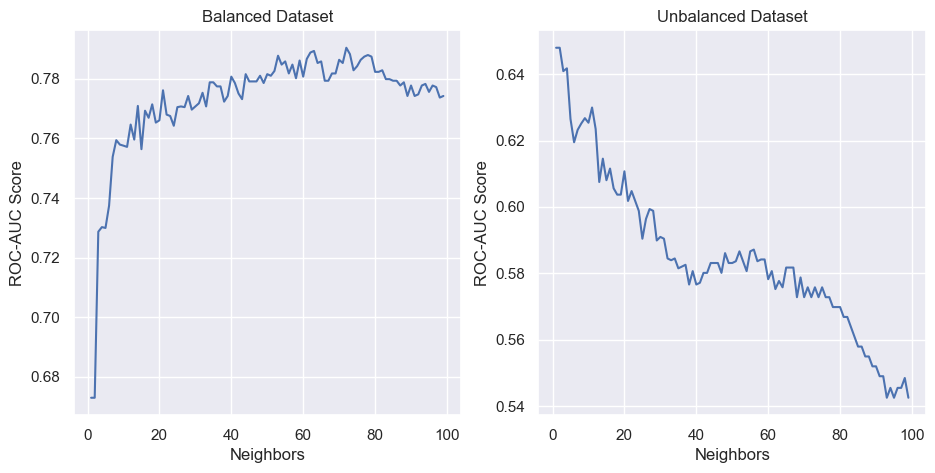

In [132]:
kmax, k_resampled_max = calculate_KNN(Xtrain_resampled,Xtrain,ytrain_resampled,ytrain,Xtest,ytest, neighbors = 100)

In [38]:
print(kmax, k_resampled_max)

1 29


In [119]:
kfold = StratifiedKFold(n_splits=6, shuffle=True, random_state=0)
metrics_resampled = [[],[],[],[]]
metrics = [[],[],[],[]]
results_resampled = []
results = []
Xtrain0 = np.array(Xnorm)
ytrain0 = np.array(y)
for train_ix, test_ix in kfold.split(Xtrain0, ytrain0):
    # select rows
    train_X, test_X = Xtrain0[train_ix], Xtrain0[test_ix]
    train_y, test_y = ytrain0[train_ix], ytrain0[test_ix]
    
    # train unbalanced
    knn_unbalanced = KNeighborsClassifier(n_neighbors = kmax, weights='distance')
    knn_unbalanced.fit(train_X, train_y)
    ypred = knn_unbalanced.predict(test_X)
    
    metrics = store_metrics(metrics, test_y, ypred)
    results.append([test_y, ypred])
    
    
    # train balanced 
    Xtrain_resampled0, ytrain_resampled0 = smote.fit_resample(train_X, train_y)
    knn_balanced = KNeighborsClassifier(n_neighbors = k_resampled_max, weights='distance')
    knn_balanced.fit(Xtrain_resampled0, ytrain_resampled0)
    ypred_resampled = knn_balanced.predict(test_X)
    
    metrics_resampled = store_metrics(metrics_resampled, test_y, ypred_resampled)
    results_resampled.append([test_y, ypred_resampled])

In [120]:
metrics_resampled = np.array(metrics_resampled)
metrics = np.array(metrics)
results_resampled = np.array(results_resampled)
results = np.array(results)

columns_resampled = ['ROC_AUC_resampled','F1_resampled','Precision_resampled','Recall_resampled']
columns = ['ROC_AUC','F1','Precision','Recall']
metrics_scores = pd.DataFrame(np.concatenate([metrics_resampled.T, metrics.T],axis=1), columns = columns_resampled + columns)
mean_score = np.mean(np.array(metrics_scores), axis=0)
mean_score0 = pd.DataFrame(mean_score.round(3).reshape(2,4), columns = columns, index=['Balanced','Unbalanced'])
mean_score0

,ROC_AUC,F1,Precision,Recall
Balanced,0.764,0.477,0.333,0.836
Unbalanced,0.643,0.419,0.555,0.336


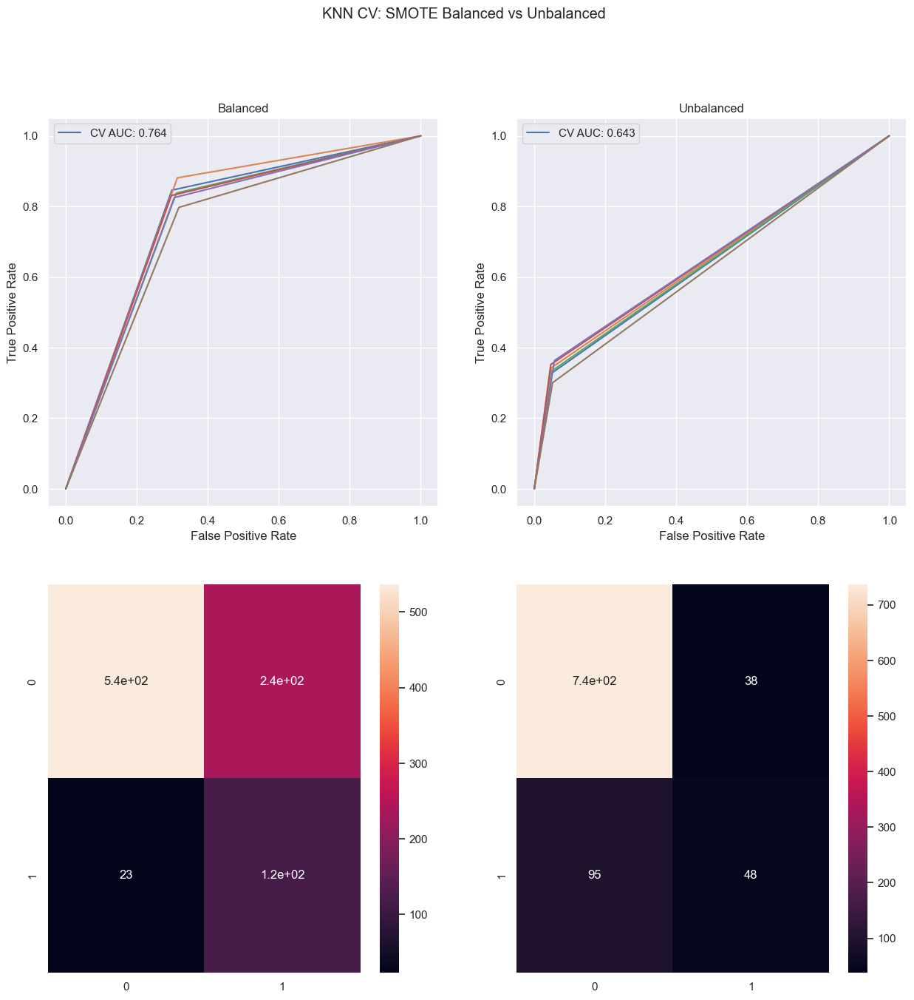

In [125]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.suptitle(f'KNN CV: SMOTE Balanced vs Unbalanced')
sns.set(font_scale = 1)

cflist = []
cflist_resampled = []
for res_resampled, res in zip(results_resampled, results):

    fpr, tpr, _ = roc_curve(res_resampled[0],  res_resampled[1])
    auc = roc_auc_score(res_resampled[0],  res_resampled[1])
    cf = confusion_matrix(res_resampled[0],  res_resampled[1])
    cflist_resampled.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,0])
    axes[0,0].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,0].set_title('Balanced')

    
    
    fpr, tpr, _ = roc_curve(res[0],  res[1])
    auc = roc_auc_score(res[0],  res[1])
    cf = confusion_matrix(res[0],  res[1])
    cflist.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,1])
    axes[0,1].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,1].set_title('Unbalanced')
    
    
axes[0,0].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][0],3)}"])
axes[0,1].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][1],3)}"])

cf = np.mean(cflist,axis=0)
cf_resampled = np.mean(cflist_resampled,axis=0)
sns.heatmap(pd.DataFrame(cf_resampled) , annot=True, ax = axes[1,0])
sns.heatmap(pd.DataFrame(cf) , annot=True, ax = axes[1,1])   
plt.show()

    

### NearMiss Undersampling

In [43]:
from imblearn.under_sampling import NearMiss
nm = NearMiss()

#split into train and test
Xtrain, Xtest, ytrain, ytest = train_test_split(Xnorm, y, test_size=0.2, random_state=13)
Xtrain_resampled, ytrain_resampled = nm.fit_resample(Xtrain, ytrain)

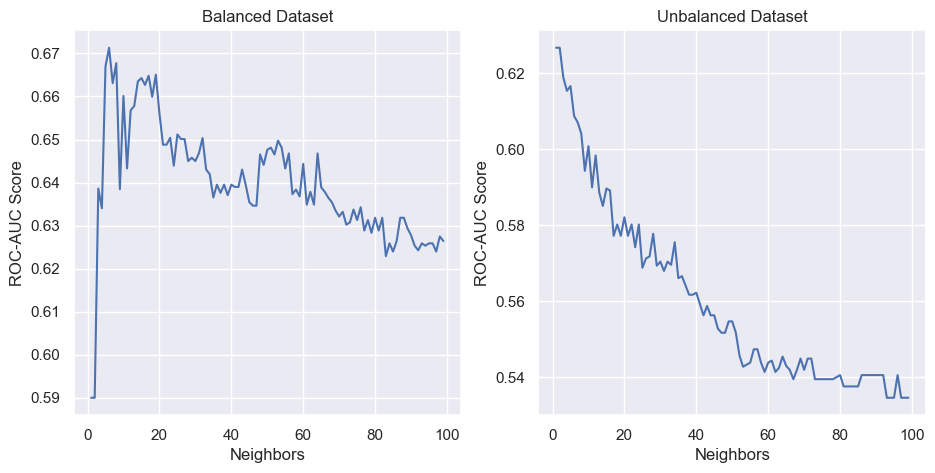

In [44]:
kmax, k_resampled_max = calculate_KNN(Xtrain_resampled,Xtrain,ytrain_resampled,ytrain,Xtest,ytest, neighbors = 100)

In [45]:
kfold = StratifiedKFold(n_splits=6, shuffle=True, random_state=0)
metrics_resampled = [[],[],[],[]]
metrics = [[],[],[],[]]
results_resampled = []
results = []
Xtrain0 = np.array(Xnorm)
ytrain0 = np.array(y)
for train_ix, test_ix in kfold.split(Xtrain0, ytrain0):
    # select rows
    train_X, test_X = Xtrain0[train_ix], Xtrain0[test_ix]
    train_y, test_y = ytrain0[train_ix], ytrain0[test_ix]
    
    # train unbalanced
    knn_unbalanced = KNeighborsClassifier(n_neighbors = kmax, weights='distance')
    knn_unbalanced.fit(train_X, train_y)
    ypred = knn_unbalanced.predict(test_X)
    
    metrics = store_metrics(metrics, test_y, ypred)
    results.append([test_y, ypred])
    
    
    # train balanced 
    Xtrain_resampled0, ytrain_resampled0 = nm.fit_resample(train_X, train_y)
    knn_balanced = KNeighborsClassifier(n_neighbors = k_resampled_max, weights='distance')
    knn_balanced.fit(Xtrain_resampled0, ytrain_resampled0)
    ypred_resampled = knn_balanced.predict(test_X)
    
    metrics_resampled = store_metrics(metrics_resampled, test_y, ypred_resampled)
    results_resampled.append([test_y, ypred_resampled])

In [46]:
metrics_resampled = np.array(metrics_resampled)
metrics = np.array(metrics)
results_resampled = np.array(results_resampled)
results = np.array(results)

columns_resampled = ['ROC_AUC_resampled','F1_resampled','Precision_resampled','Recall_resampled']
columns = ['ROC_AUC','F1','Precision','Recall']
metrics_scores = pd.DataFrame(np.concatenate([metrics_resampled.T, metrics.T],axis=1), columns = columns_resampled + columns)
mean_score = np.mean(np.array(metrics_scores), axis=0)
mean_score0 = pd.DataFrame(mean_score.round(3).reshape(2,4), columns = columns, index=['Balanced','Unbalanced'])
mean_score0

,ROC_AUC,F1,Precision,Recall
Balanced,0.659,0.392,0.305,0.548
Unbalanced,0.629,0.376,0.391,0.363


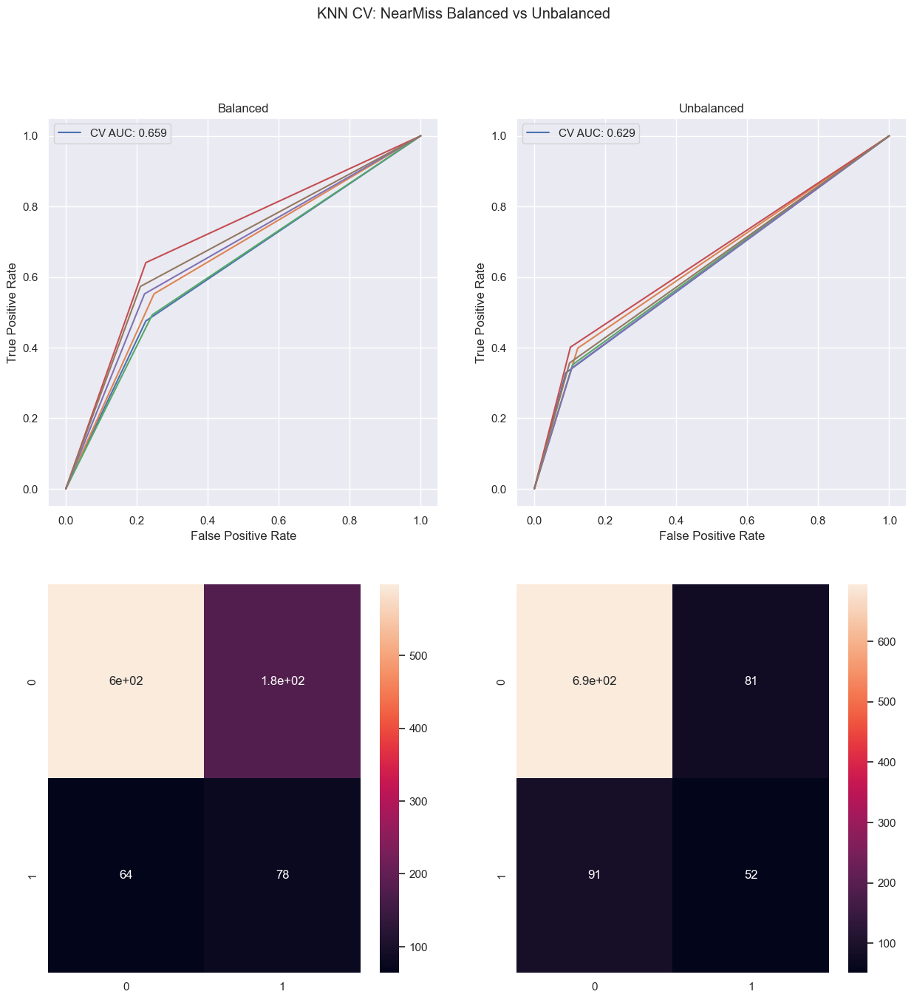

In [47]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.suptitle(f'KNN CV: NearMiss Balanced vs Unbalanced')
sns.set(font_scale = 1)

cflist = []
cflist_resampled = []
for res_resampled, res in zip(results_resampled, results):

    fpr, tpr, _ = roc_curve(res_resampled[0],  res_resampled[1])
    auc = roc_auc_score(res_resampled[0],  res_resampled[1])
    cf = confusion_matrix(res_resampled[0],  res_resampled[1])
    cflist_resampled.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,0])
    axes[0,0].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,0].set_title('Balanced')

    
    
    fpr, tpr, _ = roc_curve(res[0],  res[1])
    auc = roc_auc_score(res[0],  res[1])
    cf = confusion_matrix(res[0],  res[1])
    cflist.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,1])
    axes[0,1].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,1].set_title('Unbalanced')
    
    
axes[0,0].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][0],3)}"])
axes[0,1].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][1],3)}"])

cf = np.mean(cflist,axis=0)
cf_resampled = np.mean(cflist_resampled,axis=0)
sns.heatmap(pd.DataFrame(cf_resampled) , annot=True, ax = axes[1,0])
sns.heatmap(pd.DataFrame(cf) , annot=True, ax = axes[1,1])   
plt.show()

    

# SVM

### SMOTE Oversampling

In [48]:
Xnorm.shape

(5510, 22)

In [49]:
kfold = StratifiedKFold(n_splits=6, shuffle=True, random_state=0)
metrics_resampled = [[],[],[],[]]
metrics = [[],[],[],[]]
results_resampled = []
results = []
Xtrain0 = np.array(Xnorm)
ytrain0 = np.array(y)
for train_ix, test_ix in kfold.split(Xtrain0, ytrain0):
    # select rows
    train_X, test_X = Xtrain0[train_ix], Xtrain0[test_ix]
    train_y, test_y = ytrain0[train_ix], ytrain0[test_ix]
    
    # train unbalanced
    svm_unbalanced = SVC(kernel='rbf', class_weight = 'balanced', gamma=0.001, random_state=0)
    svm_unbalanced.fit(train_X, train_y)
    ypred = svm_unbalanced.predict(test_X)
    
    metrics = store_metrics(metrics, test_y, ypred)
    results.append([test_y, ypred])
    
    
    # train balanced 
    Xtrain_resampled0, ytrain_resampled0 = smote.fit_resample(train_X, train_y)
    svm_balanced = SVC(kernel='rbf', C = 0.03, gamma='auto', random_state=0)
    svm_balanced.fit(Xtrain_resampled0, ytrain_resampled0)
    ypred_resampled = svm_balanced.predict(test_X)
    
    metrics_resampled = store_metrics(metrics_resampled, test_y, ypred_resampled)
    results_resampled.append([test_y, ypred_resampled])
    
    
    



In [50]:
metrics_resampled = np.array(metrics_resampled)
metrics = np.array(metrics)
results_resampled = np.array(results_resampled)
results = np.array(results)

columns_resampled = ['ROC_AUC_resampled','F1_resampled','Precision_resampled','Recall_resampled']
columns = ['ROC_AUC','F1','Precision','Recall']
metrics_scores = pd.DataFrame(np.concatenate([metrics_resampled.T, metrics.T],axis=1), columns = columns_resampled + columns)
mean_score = np.mean(np.array(metrics_scores), axis=0)
mean_score0 = pd.DataFrame(mean_score.round(3).reshape(2,4), columns = columns, index=['Balanced','Unbalanced'])
mean_score0


,ROC_AUC,F1,Precision,Recall
Balanced,0.767,0.502,0.371,0.777
Unbalanced,0.777,0.517,0.386,0.783


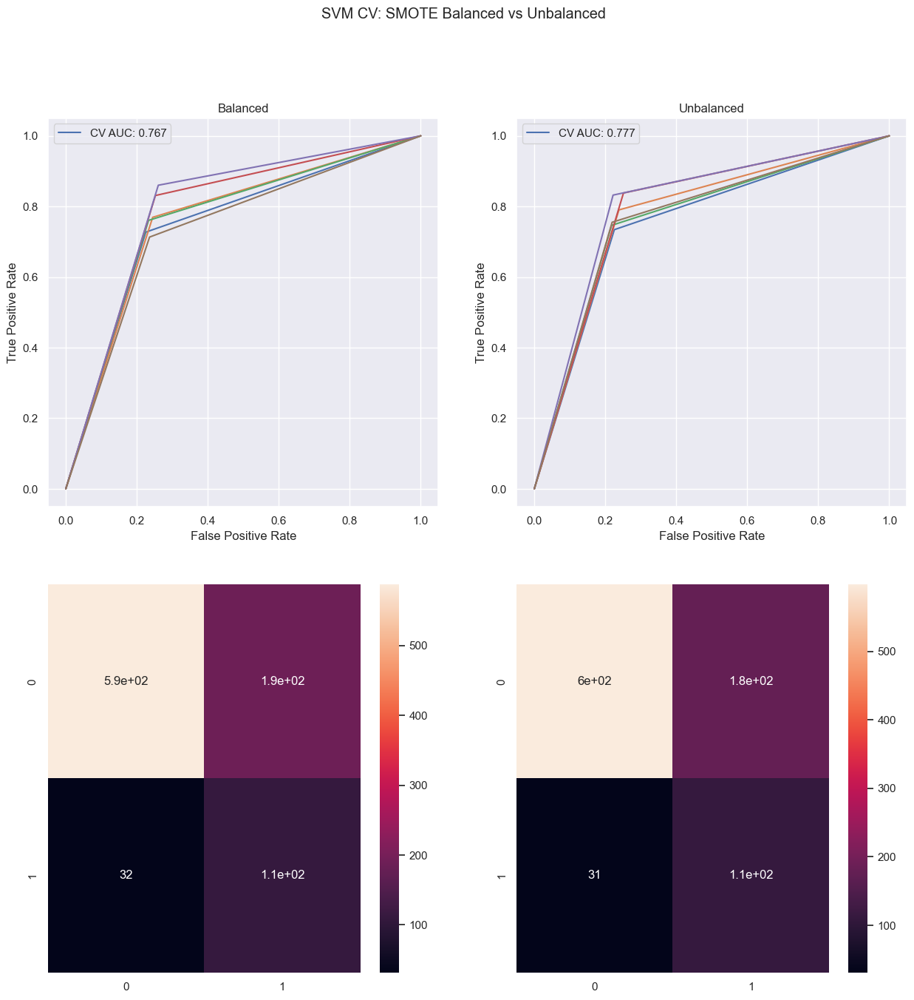

In [51]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.suptitle(f'SVM CV: SMOTE Balanced vs Unbalanced')
sns.set(font_scale = 1)

cflist = []
cflist_resampled = []
for res_resampled, res in zip(results_resampled, results):

    fpr, tpr, _ = roc_curve(res_resampled[0],  res_resampled[1])
    auc = roc_auc_score(res_resampled[0],  res_resampled[1])
    cf = confusion_matrix(res_resampled[0],  res_resampled[1])
    cflist_resampled.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,0])
    axes[0,0].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,0].set_title('Balanced')

    
    
    fpr, tpr, _ = roc_curve(res[0],  res[1])
    auc = roc_auc_score(res[0],  res[1])
    cf = confusion_matrix(res[0],  res[1])
    cflist.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,1])
    axes[0,1].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,1].set_title('Unbalanced')
    
    
axes[0,0].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][0],3)}"])
axes[0,1].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][1],3)}"])

cf = np.mean(cflist,axis=0)
cf_resampled = np.mean(cflist_resampled,axis=0)
sns.heatmap(pd.DataFrame(cf_resampled) , annot=True, ax = axes[1,0])
sns.heatmap(pd.DataFrame(cf) , annot=True, ax = axes[1,1])   
plt.show()
    
    

### NearMiss Undersampling

In [52]:
from imblearn.under_sampling import NearMiss
nm = NearMiss()


In [53]:
kfold = StratifiedKFold(n_splits=6, shuffle=True, random_state=0)
metrics_resampled = [[],[],[],[]]
metrics = [[],[],[],[]]
results_resampled = []
results = []
Xtrain0 = np.array(Xnorm)
ytrain0 = np.array(y)
for train_ix, test_ix in kfold.split(Xtrain0, ytrain0):
    # select rows
    train_X, test_X = Xtrain0[train_ix], Xtrain0[test_ix]
    train_y, test_y = ytrain0[train_ix], ytrain0[test_ix]
    
    # train unbalanced
    svm_unbalanced = SVC(kernel='rbf', class_weight = 'balanced', gamma=0.001)
    svm_unbalanced.fit(train_X, train_y)
    ypred = svm_unbalanced.predict(test_X)
    
    metrics = store_metrics(metrics, test_y, ypred)
    results.append([test_y, ypred])
    
    
    # train balanced 
    Xtrain_resampled0, ytrain_resampled0 = nm.fit_resample(train_X, train_y)
    svm_balanced = SVC(kernel='rbf', class_weight = 'balanced' , gamma=0.001)
    svm_balanced.fit(Xtrain_resampled0, ytrain_resampled0)
    ypred_resampled = svm_balanced.predict(test_X)
    
    metrics_resampled = store_metrics(metrics_resampled, test_y, ypred_resampled)
    results_resampled.append([test_y, ypred_resampled])
    
    
    



In [54]:
metrics_resampled = np.array(metrics_resampled)
metrics = np.array(metrics)
results_resampled = np.array(results_resampled)
results = np.array(results)

columns_resampled = ['ROC_AUC_resampled','F1_resampled','Precision_resampled','Recall_resampled']
columns = ['ROC_AUC','F1','Precision','Recall']
metrics_scores = pd.DataFrame(np.concatenate([metrics_resampled.T, metrics.T],axis=1), columns = columns_resampled + columns)
mean_score = np.mean(np.array(metrics_scores), axis=0)
mean_score0 = pd.DataFrame(mean_score.round(3).reshape(2,4), columns = columns, index=['Balanced','Unbalanced'])
mean_score0


,ROC_AUC,F1,Precision,Recall
Balanced,0.731,0.501,0.421,0.618
Unbalanced,0.777,0.517,0.386,0.783


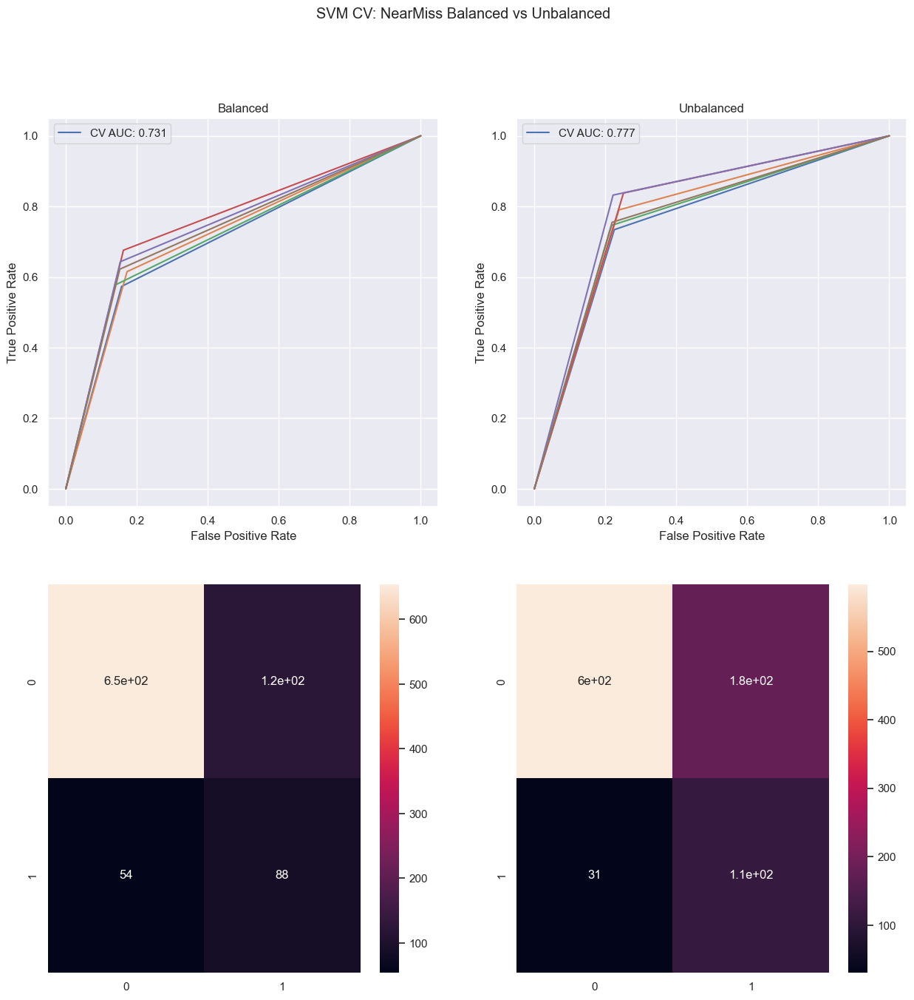

In [55]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.suptitle(f'SVM CV: NearMiss Balanced vs Unbalanced')
sns.set(font_scale = 1)

cflist = []
cflist_resampled = []
for res_resampled, res in zip(results_resampled, results):

    fpr, tpr, _ = roc_curve(res_resampled[0],  res_resampled[1])
    auc = roc_auc_score(res_resampled[0],  res_resampled[1])
    cf = confusion_matrix(res_resampled[0],  res_resampled[1])
    cflist_resampled.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,0])
    axes[0,0].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,0].set_title('Balanced')

    
    
    fpr, tpr, _ = roc_curve(res[0],  res[1])
    auc = roc_auc_score(res[0],  res[1])
    cf = confusion_matrix(res[0],  res[1])
    cflist.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,1])
    axes[0,1].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,1].set_title('Unbalanced')
    
    
axes[0,0].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][0],3)}"])
axes[0,1].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][1],3)}"])

cf = np.mean(cflist,axis=0)
cf_resampled = np.mean(cflist_resampled,axis=0)
sns.heatmap(pd.DataFrame(cf_resampled) , annot=True, ax = axes[1,0])
sns.heatmap(pd.DataFrame(cf) , annot=True, ax = axes[1,1])   
plt.show()

    

# Classification Trees

### SMOTE Oversampling

In [56]:
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.2, random_state=13)
Xtrain_resampled, ytrain_resampled = smote.fit_resample(Xtrain, ytrain)

In [57]:
Xtrain_resampled.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
0,6,23.0,39.2,0.0,11.200000,13.3,11.0,31.0,10.0,4.0,...,39.0,20.0,1015.9,1012.6,0.0,1.0,29.5,37.6,0,1
1,15,22.1,30.3,0.6,7.600000,11.5,1.0,30.0,12.0,4.0,...,58.0,63.0,1011.4,1007.6,2.0,1.0,27.1,28.1,0,12
2,27,20.9,30.3,0.0,7.600000,8.5,3.0,44.0,6.0,0.0,...,72.0,45.0,1017.7,1013.8,7.0,1.0,25.7,28.5,0,10
3,5,6.6,25.2,0.0,6.922464,11.3,5.0,41.0,8.0,9.0,...,64.0,50.0,1017.3,1015.0,0.0,5.0,17.4,24.0,0,10
4,27,16.6,27.4,0.0,6.200000,10.3,6.0,52.0,6.0,6.0,...,61.0,45.0,1019.5,1017.5,3.0,3.0,22.1,24.9,0,5


In [58]:
classi_tree = DecisionTreeClassifier(random_state=2, criterion='gini', class_weight='balanced')
classi_tree = classi_tree.fit(Xtrain_resampled, ytrain_resampled)
classi_tree.fit(Xtrain_resampled, ytrain_resampled)

ypred_resampled = classi_tree.predict(Xtest)
scores = classification_report(ytest, ypred_resampled)
roc_auc = roc_auc_score(ytest, ypred_resampled)
print('\t\t\t====Balanced===')
print(scores)
print(f'roc_auc score: {roc_auc}')

			====Balanced===
              precision    recall  f1-score   support

           0       0.90      0.84      0.87       934
           1       0.35      0.49      0.41       168

    accuracy                           0.78      1102
   macro avg       0.62      0.66      0.64      1102
weighted avg       0.82      0.78      0.80      1102

roc_auc score: 0.6621418374630366


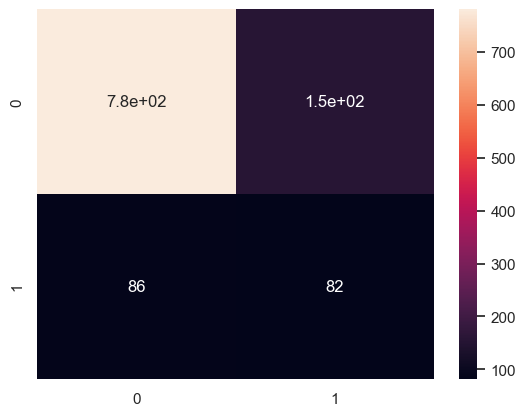

In [59]:
cf = confusion_matrix(ytest,  ypred_resampled)
sns.heatmap(pd.DataFrame(cf) , annot=True)
plt.show()

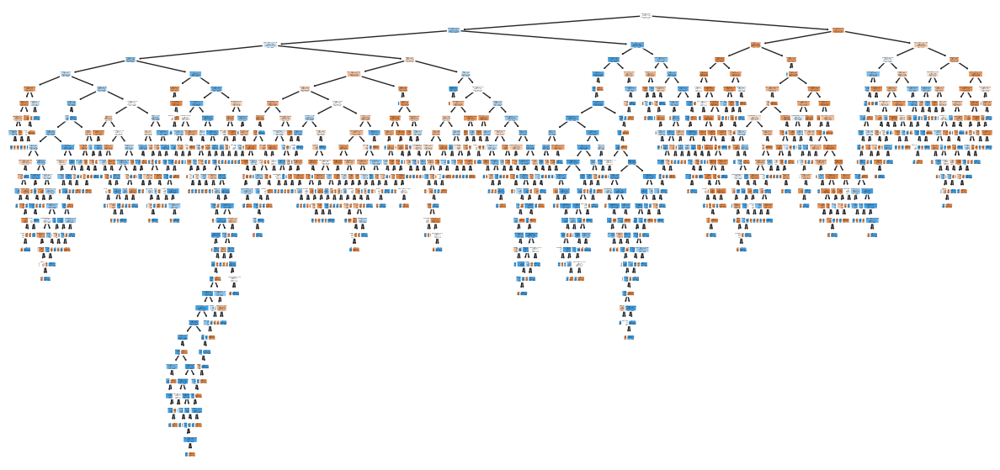

In [60]:
plt.figure(figsize=(15, 7))
plot_tree(classi_tree,
          filled=True,
          rounded=True,
          class_names=['Alive','Dead'],
          feature_names=X.columns)
plt.show()

###  Tuning CV

In [61]:
path = classi_tree.cost_complexity_pruning_path(Xtrain_resampled, ytrain_resampled)
alphas = path.ccp_alphas
ccp_alphas = alphas[:-1] #exclude the maximum value of alpha bc it leads to the the root of the tree

alpha_values = []
for a in alphas:
    classi_tree = DecisionTreeClassifier(random_state=0, ccp_alpha = a, criterion='gini', class_weight='balanced')
    scores_crossval = cross_val_score(classi_tree, Xtrain_resampled, ytrain_resampled, cv=5, scoring='roc_auc', n_jobs=-1)
    alpha_values.append([a, np.mean(scores_crossval), np.std(scores_crossval)])
    

    
alpha_results = pd.DataFrame(alpha_values, columns=['alpha', 'roc_auc', 'std'])
best_alpha = alpha_results.sort_values(by='roc_auc', ascending=False).iloc[0,0]
print(f'Best alpha: {best_alpha}')

Best alpha: 0.0009722844484269216


In [62]:
classi_tree_pruned = DecisionTreeClassifier(random_state = 2, ccp_alpha=best_alpha, criterion='gini', class_weight='balanced')
classi_tree_pruned.fit(Xtrain_resampled, ytrain_resampled)

#===========balanced
ypred = classi_tree_pruned.predict(Xtest)
scores = classification_report(ytest, ypred)
roc_auc = roc_auc_score(ytest, ypred)
print('\t\t\t====Balanced===')
print(scores)
print(f'roc_auc score: {roc_auc}')

			====Balanced===
              precision    recall  f1-score   support

           0       0.91      0.87      0.89       934
           1       0.42      0.52      0.46       168

    accuracy                           0.82      1102
   macro avg       0.66      0.70      0.68      1102
weighted avg       0.84      0.82      0.82      1102

roc_auc score: 0.696058937493627


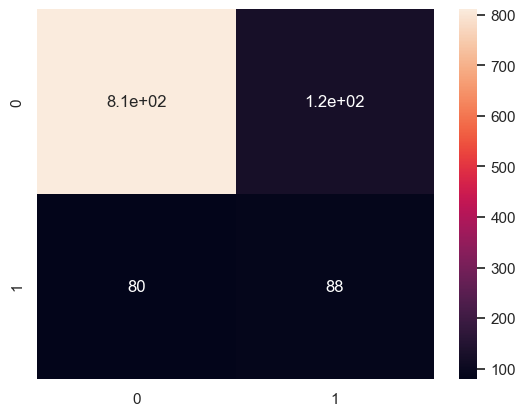

In [63]:
cf = confusion_matrix(ytest,  ypred)
sns.heatmap(pd.DataFrame(cf) , annot=True)
plt.show()

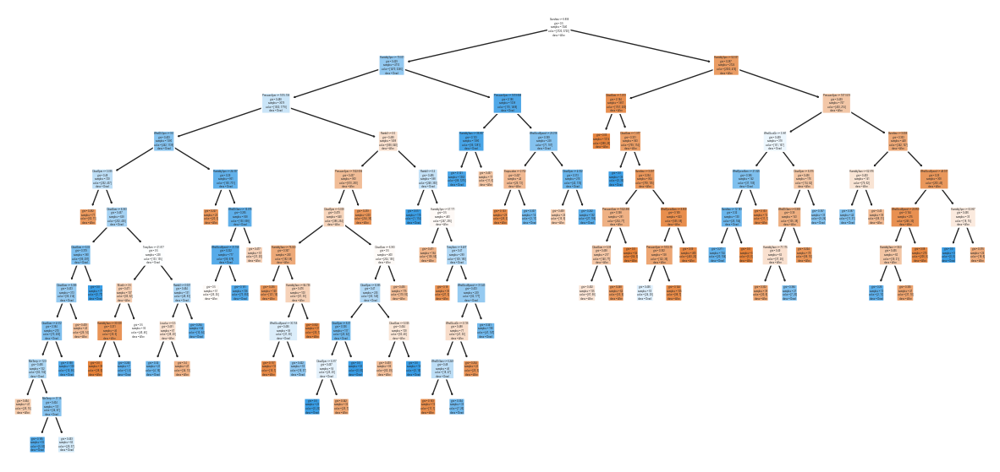

In [64]:
plt.figure(figsize=(15, 7))
plot_tree(classi_tree_pruned,
          filled=True,
          rounded=True,
          class_names=['Alive','Dead'],
          feature_names=X.columns)
plt.show()

### NearMiss Undersampling

In [65]:
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.2, random_state=13)
Xtrain_resampled, ytrain_resampled = nm.fit_resample(Xtrain, ytrain)
Xtrain.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
36556,6,23.0,39.2,0.0,11.200000,13.3,11.0,31.0,10.0,4.0,...,39.0,20.0,1015.9,1012.6,0.0,1.0,29.5,37.6,0,1
84169,15,22.1,30.3,0.6,7.600000,11.5,1.0,30.0,12.0,4.0,...,58.0,63.0,1011.4,1007.6,2.0,1.0,27.1,28.1,0,12
88581,27,20.9,30.3,0.0,7.600000,8.5,3.0,44.0,6.0,0.0,...,72.0,45.0,1017.7,1013.8,7.0,1.0,25.7,28.5,0,10
114914,5,6.6,25.2,0.0,6.922464,11.3,5.0,41.0,8.0,9.0,...,64.0,50.0,1017.3,1015.0,0.0,5.0,17.4,24.0,0,10
88065,27,16.6,27.4,0.0,6.200000,10.3,6.0,52.0,6.0,6.0,...,61.0,45.0,1019.5,1017.5,3.0,3.0,22.1,24.9,0,5


In [66]:
classi_tree = DecisionTreeClassifier(random_state=2, criterion='gini', class_weight='balanced')
classi_tree = classi_tree.fit(Xtrain_resampled, ytrain_resampled)
classi_tree.fit(Xtrain_resampled, ytrain_resampled)

ypred_resampled = classi_tree.predict(Xtest)
scores = classification_report(ytest, ypred_resampled)
roc_auc = roc_auc_score(ytest, ypred_resampled)
print('\t\t\t====Balanced===')
print(scores)
print(f'roc_auc score: {roc_auc}')

			====Balanced===
              precision    recall  f1-score   support

           0       0.90      0.50      0.64       934
           1       0.20      0.68      0.31       168

    accuracy                           0.53      1102
   macro avg       0.55      0.59      0.47      1102
weighted avg       0.79      0.53      0.59      1102

roc_auc score: 0.5917265728561232


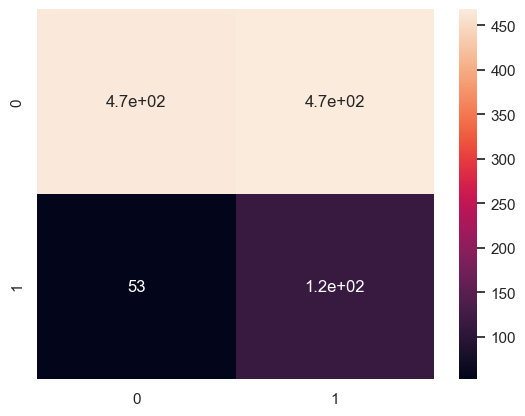

In [67]:
cf = confusion_matrix(ytest,  ypred_resampled)
sns.heatmap(pd.DataFrame(cf) , annot=True)
plt.show()

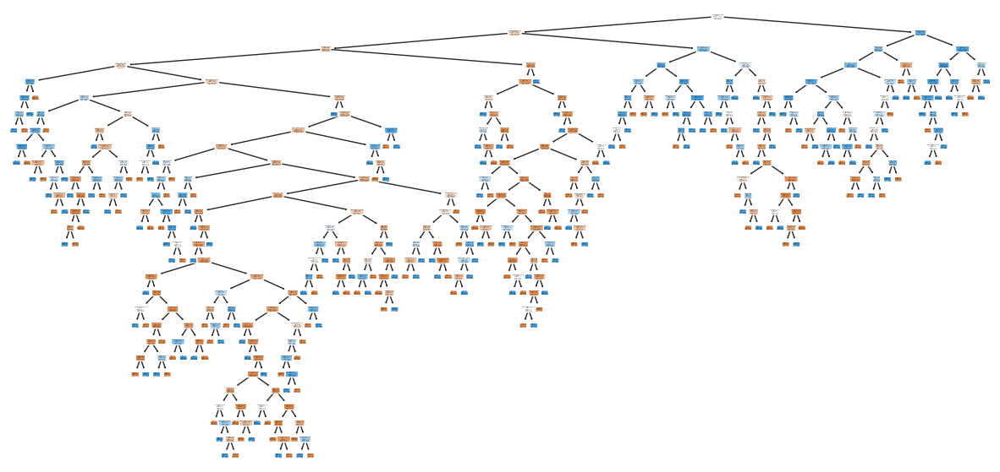

In [68]:
plt.figure(figsize=(15, 7))
plot_tree(classi_tree,
          filled=True,
          rounded=True,
          class_names=['Alive','Dead'],
          feature_names=X.columns)
plt.show()

### Tuning CV

In [69]:
path = classi_tree.cost_complexity_pruning_path(Xtrain_resampled, ytrain_resampled)
alphas = path.ccp_alphas
ccp_alphas = alphas[:-1] #exclude the maximum value of alpha bc it leads to the the root of the tree

alpha_values = []
for a in alphas:
    classi_tree = DecisionTreeClassifier(random_state=0, ccp_alpha = a, criterion='gini', class_weight='balanced')
    scores_crossval = cross_val_score(classi_tree, Xtrain_resampled, ytrain_resampled, cv=5, scoring='roc_auc', n_jobs=-1)
    alpha_values.append([a, np.mean(scores_crossval), np.std(scores_crossval)])
    

    
alpha_results = pd.DataFrame(alpha_values, columns=['alpha', 'roc_auc', 'std'])
best_alpha = alpha_results.sort_values(by='roc_auc', ascending=False).iloc[0,0]
print(f'Best alpha: {best_alpha}')

Best alpha: 0.0052133893273681176


In [70]:
classi_tree_pruned = DecisionTreeClassifier(random_state = 2, ccp_alpha=best_alpha, criterion='gini', class_weight='balanced')
classi_tree_pruned.fit(Xtrain_resampled, ytrain_resampled)

#===========balanced
ypred = classi_tree_pruned.predict(Xtest)
scores = classification_report(ytest, ypred)
roc_auc = roc_auc_score(ytest, ypred)
print('\t\t\t====Balanced===')
print(scores)
print(f'roc_auc score: {roc_auc}')

			====Balanced===
              precision    recall  f1-score   support

           0       0.92      0.73      0.82       934
           1       0.31      0.67      0.42       168

    accuracy                           0.72      1102
   macro avg       0.62      0.70      0.62      1102
weighted avg       0.83      0.72      0.76      1102

roc_auc score: 0.6984296930763739


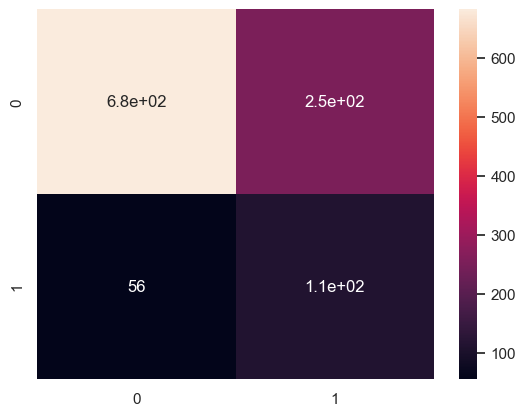

In [71]:
cf = confusion_matrix(ytest,  ypred)
sns.heatmap(pd.DataFrame(cf) , annot=True)
plt.show()

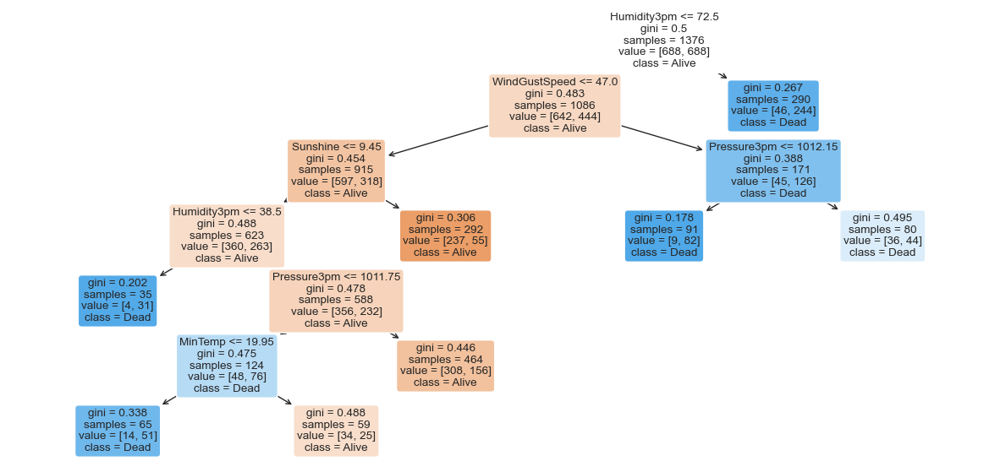

In [72]:
plt.figure(figsize=(15, 7))
plot_tree(classi_tree_pruned,
          filled=True,
          rounded=True,
          class_names=['Alive','Dead'],
          feature_names=X.columns)
plt.show()

### Unbalanced

In [73]:
Xtrain.shape

(4408, 22)

In [74]:
#===========unbalanced
classi_tree_unbalanced = DecisionTreeClassifier(random_state=2, criterion='entropy',class_weight='balanced' )
classi_tree_unbalanced = classi_tree_unbalanced.fit(Xtrain, ytrain)
classi_tree_unbalanced.fit(Xtrain, ytrain)

ypred = classi_tree_unbalanced.predict(Xtest)
scores = classification_report(ytest, ypred)
roc_auc = roc_auc_score(ytest, ypred)
print('\t\t\t====Balanced===')
print(scores)
print(f'roc_auc score: {roc_auc}')

			====Balanced===
              precision    recall  f1-score   support

           0       0.89      0.88      0.89       934
           1       0.38      0.39      0.39       168

    accuracy                           0.81      1102
   macro avg       0.63      0.64      0.64      1102
weighted avg       0.81      0.81      0.81      1102

roc_auc score: 0.6386127256041603


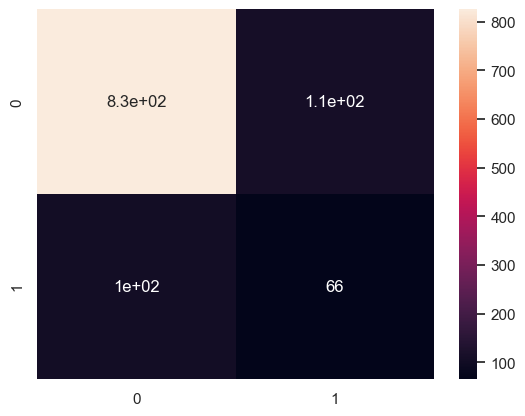

In [75]:
cf = confusion_matrix(ytest,  ypred)
sns.heatmap(pd.DataFrame(cf) , annot=True)
plt.show()

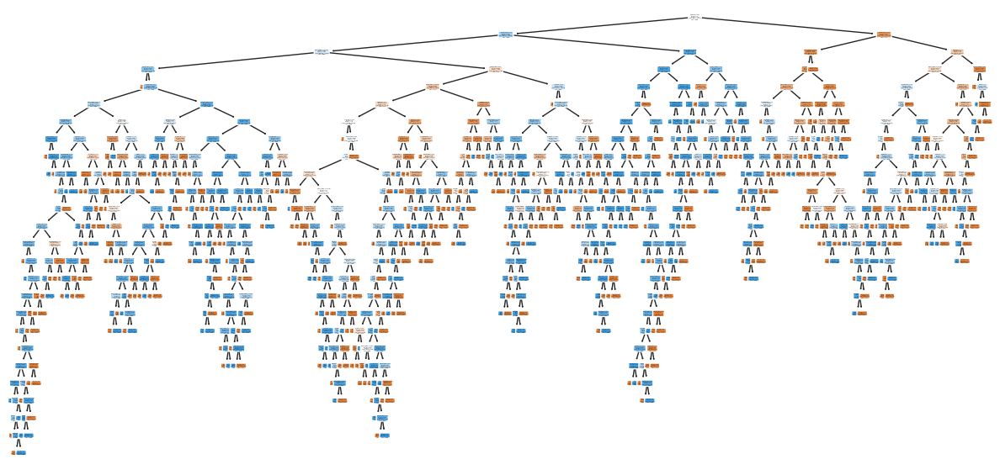

In [76]:

plt.figure(figsize=(15, 7))
plot_tree(classi_tree_unbalanced,
          filled=True,
          rounded=True,
          class_names=['Alive','Dead'],
          feature_names=X.columns)
plt.show()

### Unalanced Tuning CV

In [77]:
path = classi_tree_unbalanced.cost_complexity_pruning_path(Xtrain, ytrain)
alphas = path.ccp_alphas
ccp_alphas = alphas[:-1] #exclude the maximum value of alpha bc it leads to the the root of the tree

alpha_values = []
for a in alphas:
    classi_tree = DecisionTreeClassifier(random_state=0, ccp_alpha = a, criterion='entropy', class_weight='balanced')
    scores_crossval = cross_val_score(classi_tree, Xtrain, ytrain, cv=5, scoring='roc_auc', n_jobs=-1)
    alpha_values.append([a, np.mean(scores_crossval), np.std(scores_crossval)])
    

    
alpha_results = pd.DataFrame(alpha_values, columns=['alpha', 'roc_auc', 'std'])
best_alpha = alpha_results.sort_values(by='roc_auc', ascending=False).iloc[0,0]
print(f'Best alpha: {best_alpha}')

Best alpha: 0.006957936787553326


In [78]:
classi_tree_unbalanced_pruned = DecisionTreeClassifier(random_state = 2, ccp_alpha=best_alpha, criterion='entropy', class_weight='balanced')
classi_tree_unbalanced_pruned.fit(Xtrain, ytrain)

#===========balanced
ypred = classi_tree_unbalanced_pruned.predict(Xtest)
scores = classification_report(ytest, ypred)
roc_auc = roc_auc_score(ytest, ypred)
print('\t\t\t====Unbalanced===')
print(scores)
print(f'roc_auc score: {roc_auc}')

			====Unbalanced===
              precision    recall  f1-score   support

           0       0.93      0.77      0.84       934
           1       0.34      0.67      0.45       168

    accuracy                           0.75      1102
   macro avg       0.63      0.72      0.64      1102
weighted avg       0.84      0.75      0.78      1102

roc_auc score: 0.7166309778729478


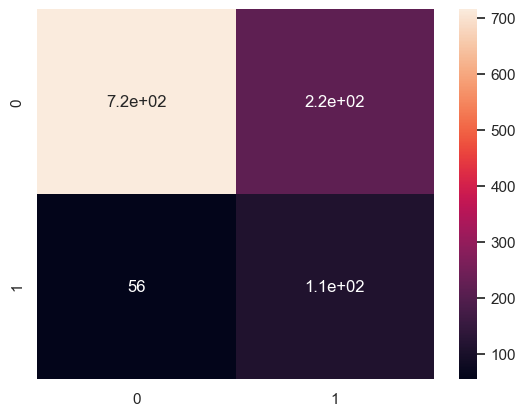

In [79]:
cf = confusion_matrix(ytest,  ypred)
sns.heatmap(pd.DataFrame(cf) , annot=True)
plt.show()

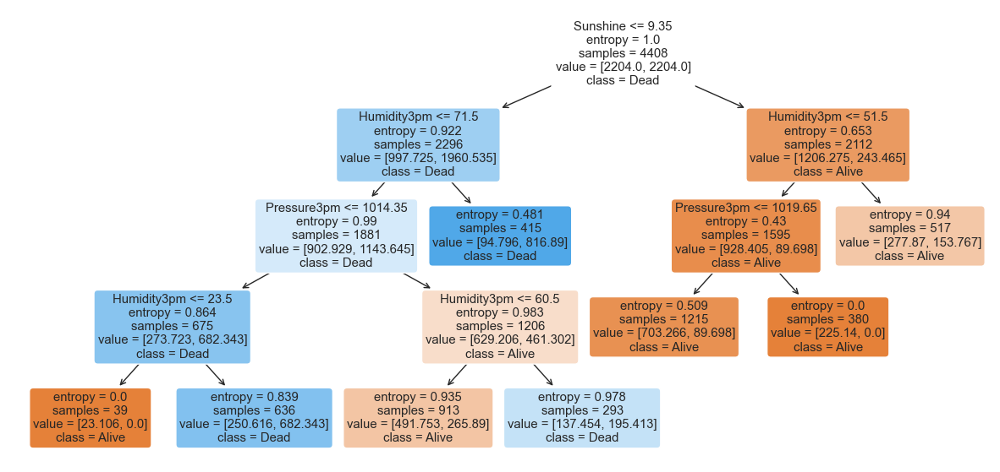

In [80]:
plt.figure(figsize=(15, 7))
plot_tree(classi_tree_unbalanced_pruned,
          filled=True,
          rounded=True,
          class_names=['Alive','Dead'],
          feature_names=X.columns)
plt.show()

# ANN

### SMOTE Oversampling

In [82]:
from tensorflow import keras
from tensorflow.keras import layers,Sequential
import tensorflow as tf

Xnorm = scale(X)
Xnorm = pd.DataFrame(Xnorm, columns=X.columns)

Xtrain, Xtest, ytrain, ytest = train_test_split(Xnorm, y, test_size=0.2, random_state=2)
Xtrain_resampled, ytrain_resampled = smote.fit_resample(Xtrain, ytrain)
Xtrain_resampled.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,Month
0,1.734302,0.037733,-0.737295,0.610000,-0.510823,-1.868299,1.357120,-0.769353,0.859190,1.571080,...,1.285207,1.301613,-0.528493,-0.444057,0.208323,0.176087,-0.504550,-0.559249,-0.23869,0.765782
1,0.526241,-0.734629,-0.412830,-0.404212,-0.374759,0.705787,1.134602,-0.066875,0.859190,1.131885,...,-0.266220,-1.040032,-0.607652,-1.013075,-1.488577,-1.626213,-0.615474,-0.226206,-0.23869,0.473535
2,1.734302,0.132308,0.189750,-0.404212,1.053909,-1.000944,-1.090583,0.133833,-1.511435,-1.503288,...,2.001250,0.811501,-0.734306,-0.143741,0.208323,0.176087,0.050071,0.249570,-0.23869,-1.279945
3,-1.285851,-0.450904,-1.030859,-0.404212,-0.714919,-1.896279,-1.313101,-1.572186,1.505725,0.143695,...,1.702899,1.247156,0.738047,0.741399,1.528134,1.577875,-0.805630,-0.844714,-0.23869,-0.110958
4,0.163823,0.573658,-0.273773,-0.404212,0.781782,0.258120,0.244528,-0.267583,-0.433878,0.253494,...,0.569163,0.103562,-0.655147,-0.554699,0.208323,0.176087,-0.029161,-0.194487,-0.23869,1.642522


In [86]:
model=tf.keras.Sequential([
    layers.Flatten(input_shape=(X.shape[1], )),
    layers.Dense(64,activation='relu'),
    layers.Dense(64,activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(128,activation='relu'),
    layers.Dense(128,activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(256,activation='relu'),
    layers.Dense(256,activation='relu'),
    layers.Dropout(0.2),
    layers.Dense(1,activation='sigmoid')
])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 22)                0         
                                                                 
 dense (Dense)               (None, 64)                1472      
                                                                 
 dense_1 (Dense)             (None, 64)                4160      
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_2 (Dense)             (None, 128)               8320      
                                                                 
 dense_3 (Dense)             (None, 128)               16512     
                                                                 
 dropout_1 (Dropout)         (None, 128)               0

In [87]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00001),
              loss='binary_crossentropy', 
              metrics=["AUC"])

callback = keras.callbacks.EarlyStopping(monitor='val_auc', patience=3)
history = model.fit(Xtrain_resampled, ytrain_resampled, 
        epochs=150,
        validation_data=(Xtest, ytest),
        batch_size=32, 
        callbacks=[callback],)

Epoch 1/150
233/233 [==============================] - 1s 3ms/step - loss: 0.6936 - auc: 0.5218 - val_loss: 0.6714 - val_auc: 0.5922
Epoch 2/150
233/233 [==============================] - 1s 2ms/step - loss: 0.6882 - auc: 0.5625 - val_loss: 0.6642 - val_auc: 0.6749
Epoch 3/150
233/233 [==============================] - 1s 3ms/step - loss: 0.6822 - auc: 0.6071 - val_loss: 0.6581 - val_auc: 0.7159
Epoch 4/150
233/233 [==============================] - 1s 3ms/step - loss: 0.6770 - auc: 0.6314 - val_loss: 0.6480 - val_auc: 0.7410
Epoch 5/150
233/233 [==============================] - 1s 3ms/step - loss: 0.6646 - auc: 0.6828 - val_loss: 0.6336 - val_auc: 0.7601
Epoch 6/150
233/233 [==============================] - 1s 3ms/step - loss: 0.6537 - auc: 0.7001 - val_loss: 0.6151 - val_auc: 0.7789
Epoch 7/150
233/233 [==============================] - 1s 3ms/step - loss: 0.6379 - auc: 0.7257 - val_loss: 0.5921 - val_auc: 0.7934
Epoch 8/150
233/233 [==============================] - 1s 2ms/step - 

<AxesSubplot:title={'center':'Loss'}>

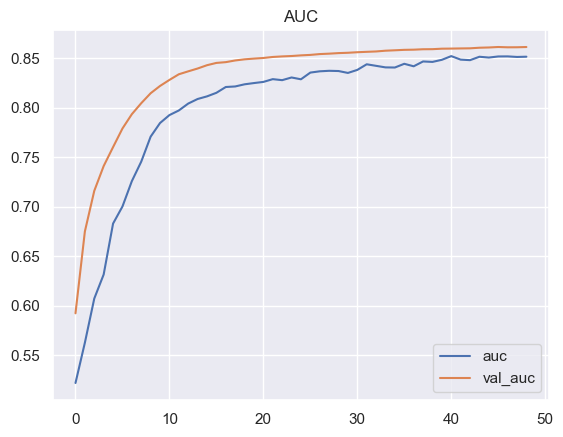

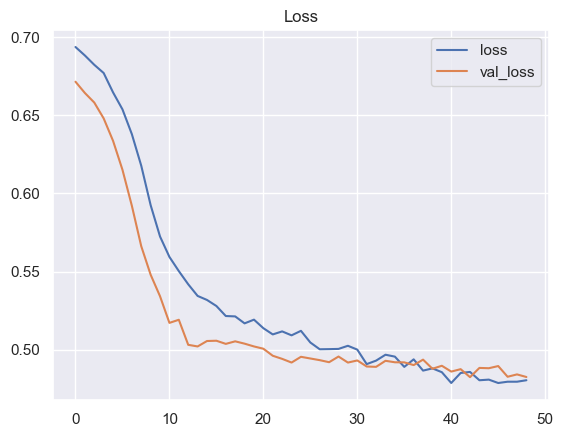

In [88]:
history_df = pd.DataFrame(history.history)
history_df.loc[:, ['auc', 'val_auc']].plot(title="AUC")
history_df.loc[:, ['loss', 'val_loss']].plot(title="Loss")

35/35 [==============================] - 0s 997us/step
              precision    recall  f1-score   support

           0       0.95      0.77      0.85       929
           1       0.38      0.77      0.51       173

    accuracy                           0.77      1102
   macro avg       0.66      0.77      0.68      1102
weighted avg       0.86      0.77      0.80      1102



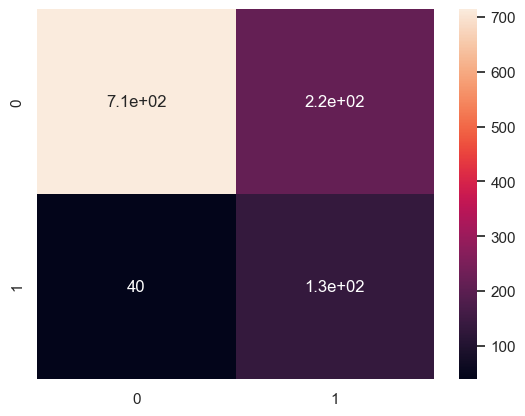

In [89]:
ypred = model.predict(Xtest)
cf = confusion_matrix(ytest, ypred.round())
sns.heatmap(pd.DataFrame(cf) , annot=True)
print(classification_report(ytest,ypred.round()))

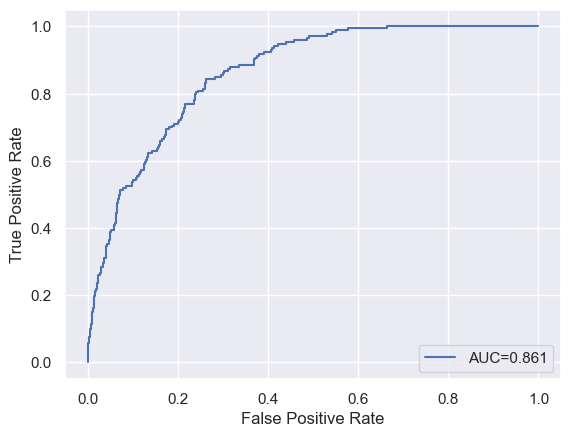

In [90]:
#create ROC curve
fpr, tpr, _ = roc_curve(ytest,  ypred)
auc = roc_auc_score(ytest, ypred)


plt.plot(fpr,tpr,label="AUC="+str(round(auc,3)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

### NearMiss Undersampling

In [91]:
from tensorflow import keras
from tensorflow.keras import layers,Sequential
import tensorflow as tf

Xnorm = scale(X)
Xnorm = pd.DataFrame(Xnorm, columns=X.columns)

Xtrain, Xtest, ytrain, ytest = train_test_split(Xnorm, y, test_size=0.2, random_state=2)
Xtrain_resampled, ytrain_resampled = nm.fit_resample(Xtrain, ytrain)

In [92]:
model=tf.keras.Sequential([
    layers.Flatten(input_shape=(X.shape[1], )),
    layers.Dense(64,activation='relu'),
    layers.Dense(64,activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(128,activation='relu'),
    layers.Dense(128,activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(256,activation='relu'),
    layers.Dense(256,activation='relu'),
    layers.Dropout(0.2),
    layers.Dense(1,activation='sigmoid')
])
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_1 (Flatten)         (None, 22)                0         
                                                                 
 dense_7 (Dense)             (None, 64)                1472      
                                                                 
 dense_8 (Dense)             (None, 64)                4160      
                                                                 
 dropout_3 (Dropout)         (None, 64)                0         
                                                                 
 dense_9 (Dense)             (None, 128)               8320      
                                                                 
 dense_10 (Dense)            (None, 128)               16512     
                                                                 
 dropout_4 (Dropout)         (None, 128)              

In [93]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00001),
              loss='binary_crossentropy', 
              metrics=["AUC"])

callback = keras.callbacks.EarlyStopping(monitor='val_auc', patience=3)
history = model.fit(Xtrain_resampled, ytrain_resampled, 
        epochs=150,
        validation_data=(Xtest, ytest),
        batch_size=32, 
        callbacks=[callback],)

Epoch 1/150
43/43 [==============================] - 1s 8ms/step - loss: 0.6988 - auc: 0.4839 - val_loss: 0.7031 - val_auc: 0.5364
Epoch 2/150
43/43 [==============================] - 0s 4ms/step - loss: 0.6920 - auc: 0.5309 - val_loss: 0.7122 - val_auc: 0.5523
Epoch 3/150
43/43 [==============================] - 0s 4ms/step - loss: 0.6936 - auc: 0.5118 - val_loss: 0.7186 - val_auc: 0.5650
Epoch 4/150
43/43 [==============================] - 0s 4ms/step - loss: 0.6861 - auc: 0.5725 - val_loss: 0.7235 - val_auc: 0.5758
Epoch 5/150
43/43 [==============================] - 0s 4ms/step - loss: 0.6933 - auc: 0.5255 - val_loss: 0.7283 - val_auc: 0.5928
Epoch 6/150
43/43 [==============================] - 0s 4ms/step - loss: 0.6865 - auc: 0.5683 - val_loss: 0.7315 - val_auc: 0.6052
Epoch 7/150
43/43 [==============================] - 0s 4ms/step - loss: 0.6852 - auc: 0.5880 - val_loss: 0.7352 - val_auc: 0.6126
Epoch 8/150
43/43 [==============================] - 0s 4ms/step - loss: 0.6860 - a

43/43 [==============================] - 0s 3ms/step - loss: 0.6269 - auc: 0.7160 - val_loss: 0.6405 - val_auc: 0.7974


<AxesSubplot:title={'center':'Loss'}>

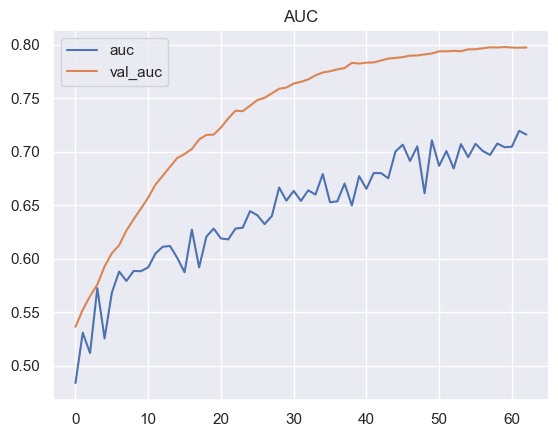

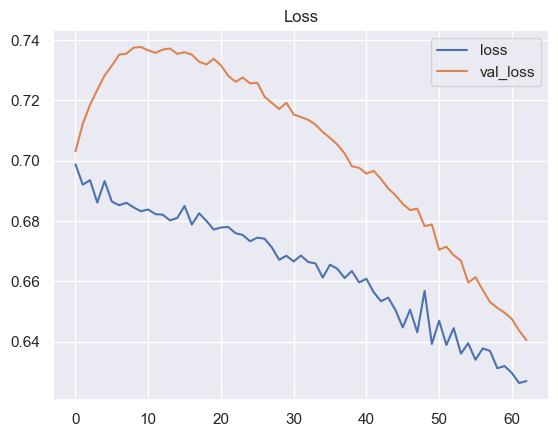

In [94]:
history_df = pd.DataFrame(history.history)
history_df.loc[:, ['auc', 'val_auc']].plot(title="AUC")
history_df.loc[:, ['loss', 'val_loss']].plot(title="Loss")

35/35 [==============================] - 0s 985us/step
              precision    recall  f1-score   support

           0       0.94      0.68      0.79       929
           1       0.31      0.76      0.44       173

    accuracy                           0.69      1102
   macro avg       0.62      0.72      0.61      1102
weighted avg       0.84      0.69      0.73      1102



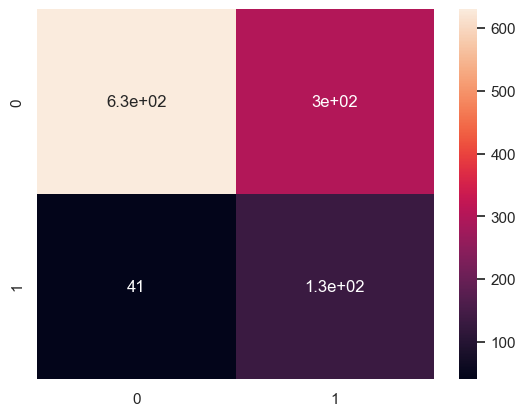

In [95]:
ypred = model.predict(Xtest)
cf = confusion_matrix(ytest, ypred.round())
sns.heatmap(pd.DataFrame(cf) , annot=True)
print(classification_report(ytest,ypred.round()))

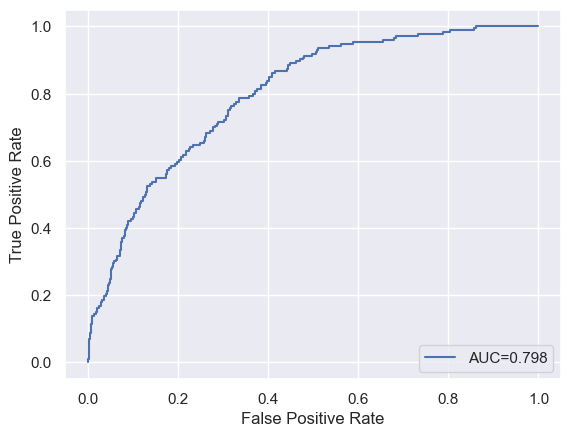

In [96]:
#create ROC curve
fpr, tpr, _ = roc_curve(ytest,  ypred)
auc = roc_auc_score(ytest, ypred)


plt.plot(fpr,tpr,label="AUC="+str(round(auc,3)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

### Unbalanced

In [97]:
Xnorm = scale(X)
Xnorm = pd.DataFrame(Xnorm, columns=X.columns)

Xtrain, Xtest, ytrain, ytest = train_test_split(Xnorm, y, test_size=0.2, random_state=2)
Xtrain_resampled, ytrain_resampled = smote.fit_resample(Xtrain, ytrain)

In [98]:
model=tf.keras.Sequential([
    layers.Flatten(input_shape=(X.shape[1], )),
    layers.Dense(64,activation='relu'),
    layers.Dense(64,activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(128,activation='relu'),
    layers.Dense(128,activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(256,activation='relu'),
    layers.Dense(256,activation='relu'),
    layers.Dropout(0.2),
    layers.Dense(1,activation='sigmoid')
])
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_2 (Flatten)         (None, 22)                0         
                                                                 
 dense_14 (Dense)            (None, 64)                1472      
                                                                 
 dense_15 (Dense)            (None, 64)                4160      
                                                                 
 dropout_6 (Dropout)         (None, 64)                0         
                                                                 
 dense_16 (Dense)            (None, 128)               8320      
                                                                 
 dense_17 (Dense)            (None, 128)               16512     
                                                                 
 dropout_7 (Dropout)         (None, 128)              

In [99]:
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00001),
              loss='binary_crossentropy', 
              metrics=["AUC"])

callback = keras.callbacks.EarlyStopping(monitor='val_auc', patience=3)
history = model.fit(Xtrain, ytrain, 
        epochs=150,
        validation_data=(Xtest, ytest),
        batch_size=32, 
        callbacks=[callback],)

Epoch 1/150
138/138 [==============================] - 1s 4ms/step - loss: 0.6584 - auc: 0.4649 - val_loss: 0.6366 - val_auc: 0.4128
Epoch 2/150
138/138 [==============================] - 0s 3ms/step - loss: 0.5733 - auc: 0.4695 - val_loss: 0.5808 - val_auc: 0.4351
Epoch 3/150
138/138 [==============================] - 0s 3ms/step - loss: 0.5105 - auc: 0.4884 - val_loss: 0.5339 - val_auc: 0.4582
Epoch 4/150
138/138 [==============================] - 0s 3ms/step - loss: 0.4748 - auc: 0.4968 - val_loss: 0.5014 - val_auc: 0.4868
Epoch 5/150
138/138 [==============================] - 0s 3ms/step - loss: 0.4577 - auc: 0.5217 - val_loss: 0.4816 - val_auc: 0.5171
Epoch 6/150
138/138 [==============================] - 0s 3ms/step - loss: 0.4473 - auc: 0.5421 - val_loss: 0.4677 - val_auc: 0.5497
Epoch 7/150
138/138 [==============================] - 0s 3ms/step - loss: 0.4415 - auc: 0.5590 - val_loss: 0.4593 - val_auc: 0.5777
Epoch 8/150
138/138 [==============================] - 0s 3ms/step - 

138/138 [==============================] - 0s 3ms/step - loss: 0.3540 - auc: 0.8042 - val_loss: 0.3411 - val_auc: 0.8472
Epoch 63/150
138/138 [==============================] - 0s 3ms/step - loss: 0.3465 - auc: 0.8143 - val_loss: 0.3403 - val_auc: 0.8475
Epoch 64/150
138/138 [==============================] - 0s 3ms/step - loss: 0.3476 - auc: 0.8137 - val_loss: 0.3394 - val_auc: 0.8480
Epoch 65/150
138/138 [==============================] - 0s 3ms/step - loss: 0.3532 - auc: 0.8081 - val_loss: 0.3403 - val_auc: 0.8485
Epoch 66/150
138/138 [==============================] - 0s 3ms/step - loss: 0.3515 - auc: 0.8086 - val_loss: 0.3392 - val_auc: 0.8488
Epoch 67/150
138/138 [==============================] - 0s 3ms/step - loss: 0.3489 - auc: 0.8127 - val_loss: 0.3390 - val_auc: 0.8490
Epoch 68/150
138/138 [==============================] - 0s 3ms/step - loss: 0.3500 - auc: 0.8083 - val_loss: 0.3389 - val_auc: 0.8490
Epoch 69/150
138/138 [==============================] - 0s 3ms/step - loss:

<AxesSubplot:title={'center':'Loss'}>

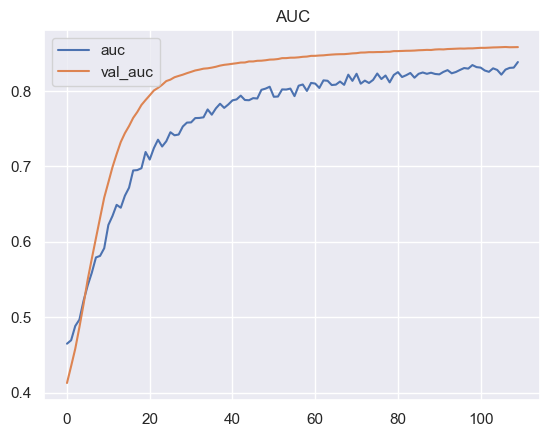

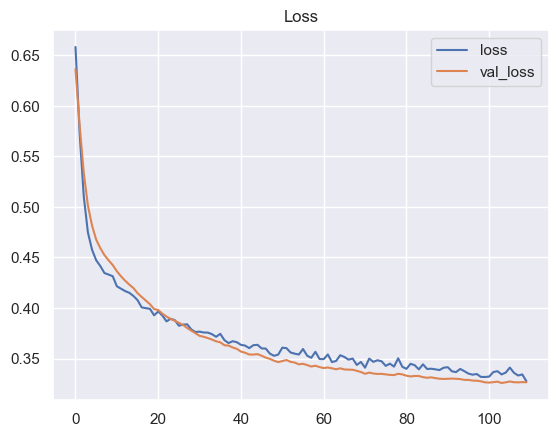

In [100]:
history_df = pd.DataFrame(history.history)
history_df.loc[:, ['auc', 'val_auc']].plot(title="AUC")
history_df.loc[:, ['loss', 'val_loss']].plot(title="Loss")

35/35 [==============================] - 0s 988us/step
              precision    recall  f1-score   support

           0       0.89      0.94      0.92       929
           1       0.56      0.40      0.47       173

    accuracy                           0.86      1102
   macro avg       0.73      0.67      0.69      1102
weighted avg       0.84      0.86      0.85      1102



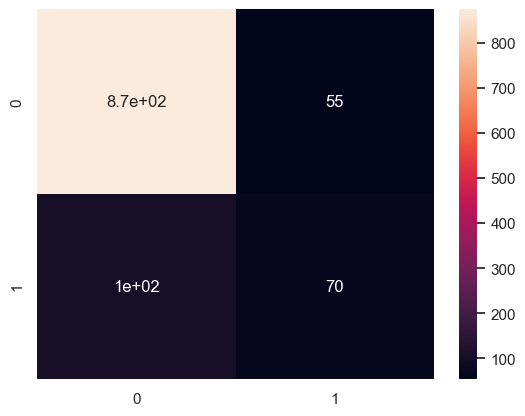

In [101]:
ypred = model.predict(Xtest)
cf = confusion_matrix(ytest, ypred.round())
sns.heatmap(pd.DataFrame(cf) , annot=True)
print(classification_report(ytest,ypred.round()))

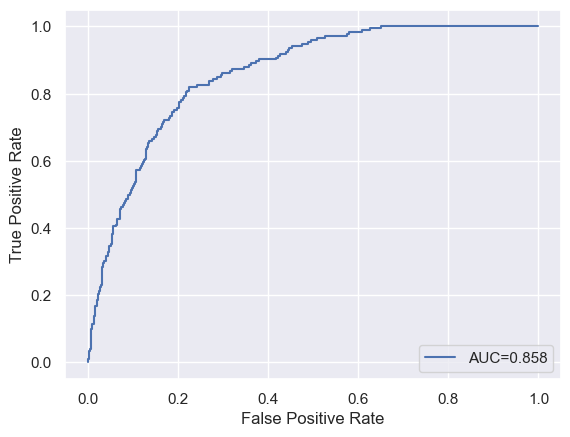

In [102]:
#create ROC curve
fpr, tpr, _ = roc_curve(ytest,  ypred)
auc = roc_auc_score(ytest, ypred)


plt.plot(fpr,tpr,label="AUC="+str(round(auc,3)))
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

 # Rule Induction: RIPPER

### SMOTE Oversampling

In [103]:
import wittgenstein as witt
from sklearn.model_selection import GridSearchCV
from imblearn.under_sampling import NearMiss


In [126]:
help(witt.RIPPER)

Help on class RIPPER in module wittgenstein.ripper:

class RIPPER(wittgenstein.abstract_ruleset_classifier.AbstractRulesetClassifier)
 |  RIPPER(k=2, dl_allowance=64, prune_size=0.33, n_discretize_bins=10, max_rules=None, max_rule_conds=None, max_total_conds=None, random_state=None, verbosity=0)
 |  
 |  Class for generating ruleset classification models.
 |  See Cohen (1995): https://www.let.rug.nl/nerbonne/teach/learning/cohen95fast.pdf
 |  
 |  Method resolution order:
 |      RIPPER
 |      wittgenstein.abstract_ruleset_classifier.AbstractRulesetClassifier
 |      abc.ABC
 |      builtins.object
 |  
 |  Methods defined here:
 |  
 |  __init__(self, k=2, dl_allowance=64, prune_size=0.33, n_discretize_bins=10, max_rules=None, max_rule_conds=None, max_total_conds=None, random_state=None, verbosity=0)
 |      Create a RIPPER classifier.
 |      
 |      Parameters
 |      ----------
 |      k : int, default=2
 |          Number of RIPPERk optimization iterations.
 |      prune_size : 

In [104]:
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.2, random_state=13)
Xtrain_resampled, ytrain_resampled = smote.fit_resample(Xtrain, ytrain)

In [130]:
kfold = StratifiedKFold(n_splits=6, shuffle=True, random_state=0)
metrics_resampled = [[],[],[],[]]
metrics = [[],[],[],[]]
results_resampled = []
results = []
Xtrain0 = np.array(X)
ytrain0 = np.array(y)
for train_ix, test_ix in kfold.split(Xtrain0, ytrain0):
    # select rows
    train_X, test_X = Xtrain0[train_ix], Xtrain0[test_ix]
    train_y, test_y = ytrain0[train_ix], ytrain0[test_ix]
    
    # train unbalanced
    ripper = witt.RIPPER(prune_size=0.001, k=3, random_state=0, verbosity = 1)
    ripper.fit(train_X, train_y)
    ypred = ripper.predict(test_X)
    
    metrics = store_metrics(metrics, test_y, ypred)
    results.append([test_y, ypred])
    

    
    
    # train balanced 
    Xtrain_resampled0, ytrain_resampled0 = smote.fit_resample(train_X, train_y)
    ripper = witt.RIPPER(prune_size=0.001, k=3,random_state=0)
    ripper.fit(Xtrain_resampled0, ytrain_resampled0)
    ypred_resampled = ripper.predict(test_X)

    
    metrics_resampled = store_metrics(metrics_resampled, test_y, ypred_resampled)
    results_resampled.append([test_y, ypred_resampled])

    
    



discretizing 19 features

GREW INITIAL RULESET:
[[13=>72.0] V
[13=64.0-72.0] V
[13=58.0-64.0] V
[17=7.0] V
[7=>52.0 ^ 13=53.0-58.0] V
[5=4.9-6.7] V
[5=2.3-4.9] V
[5=<2.3] V
[5=6.7-8.1] V
[13=53.0-58.0 ^ 15=<1008.0] V
[5=8.1-9.1] V
[5=9.1-9.9]]

optimization run 1 of 3

OPTIMIZED RULESET:
[[13=>72.0] V
[13=64.0-72.0] V
[13=58.0-64.0] V
[17=7.0] V
[7=>52.0 ^ 13=53.0-58.0] V
[5=4.9-6.7] V
[5=2.3-4.9] V
[5=<2.3] V
[5=6.7-8.1] V
[13=53.0-58.0 ^ 15=<1008.0] V
[5=8.1-9.1] V
[5=9.1-9.9]]

No changes were made. Halting optimization.
GREW FINAL RULES
[[13=>72.0] V
[13=64.0-72.0] V
[13=58.0-64.0] V
[17=7.0] V
[7=>52.0 ^ 13=53.0-58.0] V
[5=4.9-6.7] V
[5=2.3-4.9] V
[5=<2.3] V
[5=6.7-8.1] V
[13=53.0-58.0 ^ 15=<1008.0] V
[5=8.1-9.1] V
[5=9.1-9.9] V
[13=>72.0] V
[13=64.0-72.0] V
[13=58.0-64.0] V
[17=7.0] V
[7=>52.0 ^ 13=53.0-58.0] V
[5=4.9-6.7] V
[5=2.3-4.9] V
[5=<2.3] V
[5=6.7-8.1] V
[13=53.0-58.0 ^ 15=<1008.0] V
[5=8.1-9.1] V
[5=9.1-9.9] V
[15=1008.0-1010.3 ^ 10=9.0-11.0] V
[20=1.0] V
[8=2.0-4.0 ^ 2

In [106]:
metrics_resampled = np.array(metrics_resampled)
metrics = np.array(metrics)
results_resampled = np.array(results_resampled)
results = np.array(results)

columns_resampled = ['ROC_AUC_resampled','F1_resampled','Precision_resampled','Recall_resampled']
columns = ['ROC_AUC','F1','Precision','Recall']
metrics_scores = pd.DataFrame(np.concatenate([metrics_resampled.T, metrics.T],axis=1), columns = columns_resampled + columns)
mean_score = np.mean(np.array(metrics_scores), axis=0)
mean_score0 = pd.DataFrame(mean_score.round(3).reshape(2,4), columns = columns, index=['Balanced','Unbalanced'])
mean_score0


,ROC_AUC,F1,Precision,Recall
Balanced,0.658,0.377,0.399,0.565
Unbalanced,0.700,0.439,0.342,0.632


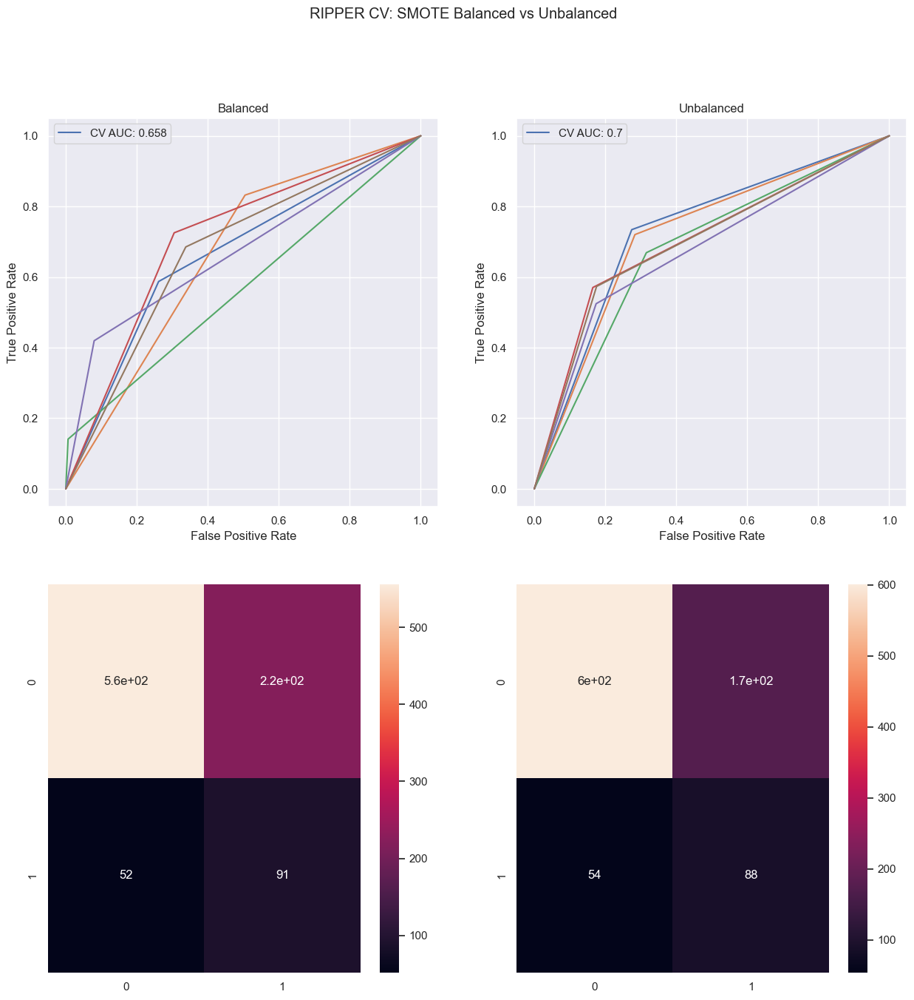

In [107]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.suptitle(f'RIPPER CV: SMOTE Balanced vs Unbalanced')
sns.set(font_scale = 1)

cflist = []
cflist_resampled = []
for res_resampled, res in zip(results_resampled, results):

    fpr, tpr, _ = roc_curve(res_resampled[0],  res_resampled[1])
    auc = roc_auc_score(res_resampled[0],  res_resampled[1])
    cf = confusion_matrix(res_resampled[0],  res_resampled[1])
    cflist_resampled.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,0])
    axes[0,0].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,0].set_title('Balanced')

    
    
    fpr, tpr, _ = roc_curve(res[0],  res[1])
    auc = roc_auc_score(res[0],  res[1])
    cf = confusion_matrix(res[0],  res[1])
    cflist.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,1])
    axes[0,1].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,1].set_title('Unbalanced')
    
    
axes[0,0].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][0],3)}"])
axes[0,1].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][1],3)}"])

cf = np.median(cflist,axis=0)
cf_resampled = np.median(cflist_resampled,axis=0)
sns.heatmap(pd.DataFrame(cf_resampled) , annot=True, ax = axes[1,0])
sns.heatmap(pd.DataFrame(cf) , annot=True, ax = axes[1,1])   
plt.show()

    
    

### NearMiss Undersampling

In [108]:
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.2, random_state=13)
Xtrain_resampled, ytrain_resampled = nm.fit_resample(Xtrain, ytrain)

In [109]:
kfold = StratifiedKFold(n_splits=6, shuffle=True, random_state=0)
metrics_resampled = [[],[],[],[]]
metrics = [[],[],[],[]]
results_resampled = []
results = []
Xtrain0 = np.array(X)
ytrain0 = np.array(y)
for train_ix, test_ix in kfold.split(Xtrain0, ytrain0):
    # select rows
    train_X, test_X = Xtrain0[train_ix], Xtrain0[test_ix]
    train_y, test_y = ytrain0[train_ix], ytrain0[test_ix]
    
    # train unbalanced
    ripper = witt.RIPPER(prune_size=0.001, k=3, random_state=0)
    ripper.fit(train_X, train_y)
    ypred = ripper.predict(test_X)
    
    metrics = store_metrics(metrics, test_y, ypred)
    results.append([test_y, ypred])
    

    
    
    # train balanced 
    Xtrain_resampled0, ytrain_resampled0 = nm.fit_resample(train_X, train_y)
    ripper = witt.RIPPER(prune_size=0.001, k=3,random_state=0)
    ripper.fit(Xtrain_resampled0, ytrain_resampled0)
    ypred_resampled = ripper.predict(test_X)

    
    metrics_resampled = store_metrics(metrics_resampled, test_y, ypred_resampled)
    results_resampled.append([test_y, ypred_resampled])

    
    



In [110]:
metrics_resampled = np.array(metrics_resampled)
metrics = np.array(metrics)
results_resampled = np.array(results_resampled)
results = np.array(results)

columns_resampled = ['ROC_AUC_resampled','F1_resampled','Precision_resampled','Recall_resampled']
columns = ['ROC_AUC','F1','Precision','Recall']
metrics_scores = pd.DataFrame(np.concatenate([metrics_resampled.T, metrics.T],axis=1), columns = columns_resampled + columns)
mean_score = np.mean(np.array(metrics_scores), axis=0)
mean_score0 = pd.DataFrame(mean_score.round(3).reshape(2,4), columns = columns, index=['Balanced','Unbalanced'])
mean_score0


,ROC_AUC,F1,Precision,Recall
Balanced,0.561,0.296,0.194,0.664
Unbalanced,0.700,0.439,0.342,0.632


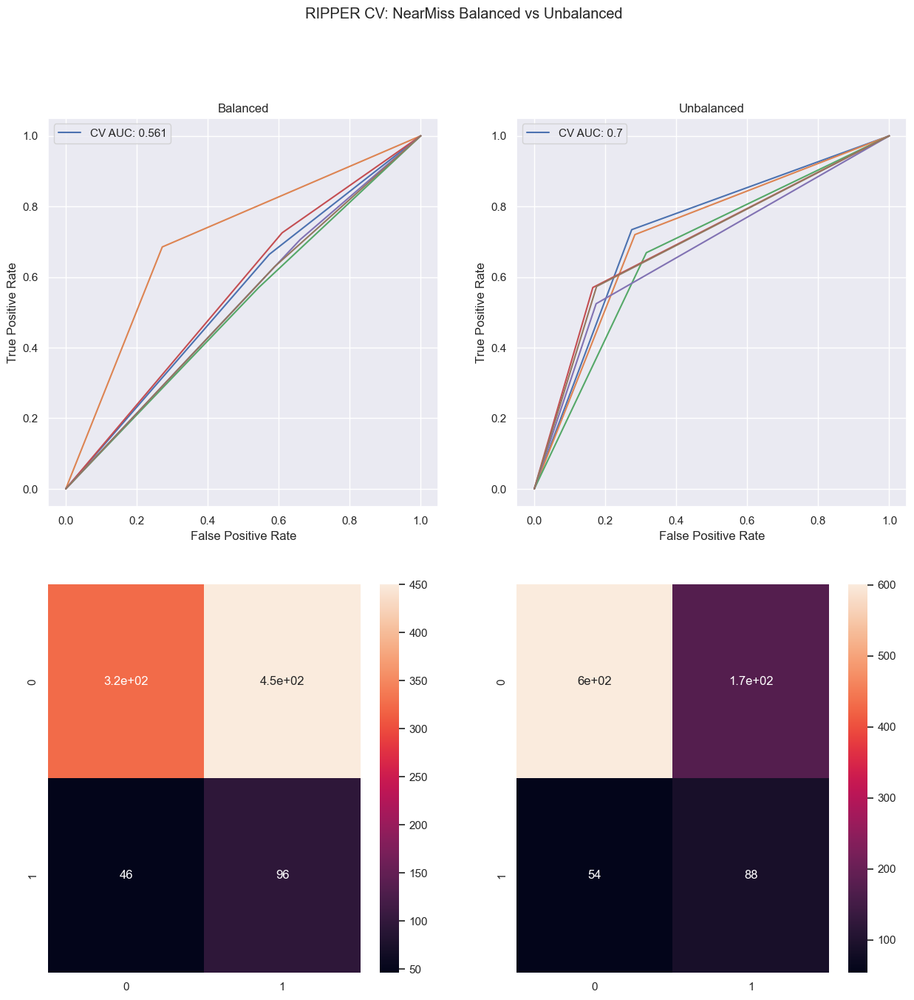

In [111]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.suptitle(f'RIPPER CV: NearMiss Balanced vs Unbalanced')
sns.set(font_scale = 1)

cflist = []
cflist_resampled = []
for res_resampled, res in zip(results_resampled, results):

    fpr, tpr, _ = roc_curve(res_resampled[0],  res_resampled[1])
    auc = roc_auc_score(res_resampled[0],  res_resampled[1])
    cf = confusion_matrix(res_resampled[0],  res_resampled[1])
    cflist_resampled.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,0])
    axes[0,0].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,0].set_title('Balanced')

    
    
    fpr, tpr, _ = roc_curve(res[0],  res[1])
    auc = roc_auc_score(res[0],  res[1])
    cf = confusion_matrix(res[0],  res[1])
    cflist.append(cf)
    sns.lineplot(x=fpr,y=tpr,ax = axes[0,1])
    axes[0,1].set(xlabel='False Positive Rate', ylabel='True Positive Rate')
    axes[0,1].set_title('Unbalanced')
    
    
axes[0,0].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][0],3)}"])
axes[0,1].legend([f"CV AUC: {round(mean_score0['ROC_AUC'][1],3)}"])

cf = np.median(cflist,axis=0)
cf_resampled = np.median(cflist_resampled,axis=0)
sns.heatmap(pd.DataFrame(cf_resampled) , annot=True, ax = axes[1,0])
sns.heatmap(pd.DataFrame(cf) , annot=True, ax = axes[1,1])   
plt.show()

    
    